<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstone-final/blob/main/code/attention/ImageCaptionGroup3_Attention_VGG16.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Reference (GitHub):- https://github.com/hlamba28/Automatic-Image-Captioning/blob/master/Automatic%20Image%20Captioning.ipynb

In [ ]:
!rm -rf Flickr8k_Dataset.zip
!rm -rf Flickr8k_text.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip -O Flickr8k_Dataset.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip -O Flickr8k_text.zip
!unzip Flickr8k_Dataset.zip
!unzip Flickr8k_text.zip

Streaming output truncated to the last 5000 lines.
  inflating: __MACOSX/Flicker8k_Dataset/._3429391520_930b153f94.jpg  
  inflating: Flicker8k_Dataset/3429465163_fb8ac7ce7f.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429465163_fb8ac7ce7f.jpg  
  inflating: Flicker8k_Dataset/3429581486_4556471d1a.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429581486_4556471d1a.jpg  
  inflating: Flicker8k_Dataset/3429641260_2f035c1813.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429641260_2f035c1813.jpg  
  inflating: Flicker8k_Dataset/3429956016_3c7e3096c2.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429956016_3c7e3096c2.jpg  
  inflating: Flicker8k_Dataset/3430100177_5864bf1e73.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430100177_5864bf1e73.jpg  
  inflating: Flicker8k_Dataset/3430287726_94a1825bbf.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430287726_94a1825bbf.jpg  
  inflating: Flicker8k_Dataset/3430526230_234b3550f6.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430

In [ ]:

import numpy as np
from numpy import array
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import string
import os
from PIL import Image
import glob
from pickle import dump, load
from time import time
from keras.preprocessing import sequence
from keras.models import Sequential
from keras import optimizers
from keras import Input, layers
from keras.applications.inception_v3 import preprocess_input
from keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector, Activation, Flatten, Reshape, concatenate, Dropout, BatchNormalization
from keras.layers.wrappers import Bidirectional
from keras.layers.merge import add
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.models import Model
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.utils import plot_model
from nltk.translate.bleu_score import sentence_bleu
import tensorflow as tf

In [ ]:
import string
import numpy as np
import pandas as pd
from numpy import array
from pickle import load

from PIL import Image
import pickle
from collections import Counter
import matplotlib.pyplot as plt

import sys, time, os, warnings
warnings.filterwarnings("ignore")
import re

import keras
import tensorflow as tf
from tqdm import tqdm
from nltk.translate.bleu_score import sentence_bleu

from keras.preprocessing.sequence import pad_sequences
# from keras.utils import to_categorical
# from keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from keras.applications.vgg16 import VGG16, preprocess_input

from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [ ]:
image_path = "/content/Flicker8k_Dataset"
dir_Flickr_text = "/content/Flickr8k.token.txt"
jpgs = os.listdir(image_path)

print("Total Images in Dataset = {}".format(len(jpgs)))

Total Images in Dataset = 8091


In [ ]:
dir_Flickr_text

'/content/Flickr8k.token.txt'

In [ ]:
# from keras.optimizers import Adam, RMSprop
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam, RMSprop

In [ ]:
# load doc into memory
def load_doc(filename):
	# open the file as read only
	file = open(filename, 'r')
	# read all text
	text = file.read()
	# close the file
	file.close()
	return text

filename = "/content/Flickr8k.token.txt"
# load descriptions
doc = load_doc(filename)
print(doc[:300])

1000268201_693b08cb0e.jpg#0	A child in a pink dress is climbing up a set of stairs in an entry way .
1000268201_693b08cb0e.jpg#1	A girl going into a wooden building .
1000268201_693b08cb0e.jpg#2	A little girl climbing into a wooden playhouse .
1000268201_693b08cb0e.jpg#3	A little girl climbing the s


In [ ]:
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
   col = line.split('\t')
   if len(col) == 1:
       continue
   w = col[0].split("#")
   datatxt.append(w + [col[1].lower()])

data = pd.DataFrame(datatxt,columns=["filename","index","caption"])
data = data.reindex(columns =['index','filename','caption'])
data = data[data.filename != '2258277193_586949ec62.jpg.1']
uni_filenames = np.unique(data.filename.values)

data.head()

,index,filename,caption
0,0,1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set o...
1,1,1000268201_693b08cb0e.jpg,a girl going into a wooden building .
2,2,1000268201_693b08cb0e.jpg,a little girl climbing into a wooden playhouse .
3,3,1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playh...
4,4,1000268201_693b08cb0e.jpg,a little girl in a pink dress going into a woo...


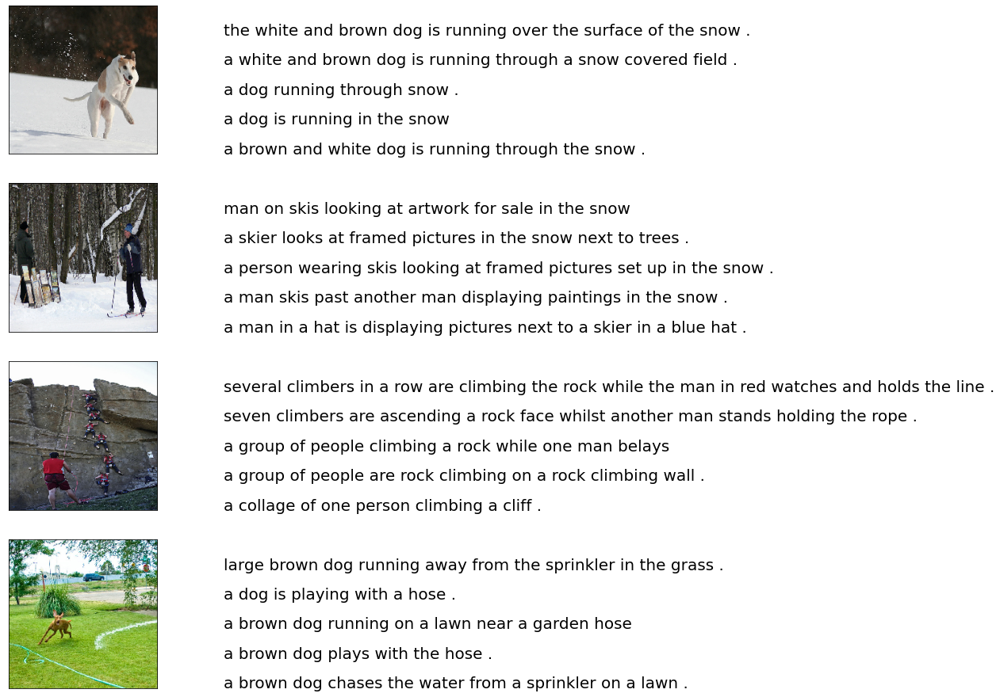

In [ ]:
npic = 5
npix = 224
target_size = (npix,npix,3)  #224,224,3
count = 1

fig = plt.figure(figsize=(10,20))
for jpgfnm in uni_filenames[10:14]:
   filename = image_path + '/' + jpgfnm
   captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
   image_load = load_img(filename, target_size=target_size)
   ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
   ax.imshow(image_load)
   count += 1

   ax = fig.add_subplot(npic,2,count)
   plt.axis('off')
   ax.plot()
   ax.set_xlim(0,1)
   ax.set_ylim(0,len(captions))
   for i, caption in enumerate(captions):
       ax.text(0,i,caption,fontsize=20)
   count += 1
plt.show()

In [ ]:
vocabulary = []
for txt in data.caption.values:
   vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 8918


In [ ]:
def remove_punctuation(text_original):
   text_no_punctuation = text_original.translate(string.punctuation)
   return(text_no_punctuation)

def remove_single_character(text):
   text_len_more_than1 = ""
   for word in text.split():
       if len(word) > 1:
           text_len_more_than1 += " " + word
   return(text_len_more_than1)

def remove_numeric(text):
   text_no_numeric = ""
   for word in text.split():
       isalpha = word.isalpha()
       if isalpha:
           text_no_numeric += " " + word
   return(text_no_numeric)

def text_clean(text_original):
   text = remove_punctuation(text_original)
   text = remove_single_character(text)
   text = remove_numeric(text)
   return(text)

for i, caption in enumerate(data.caption.values):
   newcaption = text_clean(caption)
   data["caption"].iloc[i] = newcaption

In [ ]:
clean_vocabulary = []
for txt in data.caption.values:
   clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 8357


In [ ]:
PATH = "/content/Flicker8k_Dataset/"
all_captions = []
for caption  in data["caption"].astype(str):
   caption = '<start> ' + caption+ ' <end>'
   all_captions.append(caption)

all_captions[:10]

['<start>  child in pink dress is climbing up set of stairs in an entry way <end>',
 '<start>  girl going into wooden building <end>',
 '<start>  little girl climbing into wooden playhouse <end>',
 '<start>  little girl climbing the stairs to her playhouse <end>',
 '<start>  little girl in pink dress going into wooden cabin <end>',
 '<start>  black dog and spotted dog are fighting <end>',
 '<start>  black dog and dog playing with each other on the road <end>',
 '<start>  black dog and white dog with brown spots are staring at each other in the street <end>',
 '<start>  two dogs of different breeds looking at each other on the road <end>',
 '<start>  two dogs on pavement moving toward each other <end>']

In [ ]:
all_img_name_vector = []
for annot in data["filename"]:
   full_image_path = PATH + annot
   all_img_name_vector.append(full_image_path)

all_img_name_vector[:10]

['/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg']

In [ ]:
#Clarify
def data_limiter(num,total_captions,all_img_name_vector):
 train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
 train_captions = train_captions[:num]
 img_name_vector = img_name_vector[:num]
 return train_captions,img_name_vector

train_captions,img_name_vector = data_limiter(40000,all_captions,all_img_name_vector)

In [ ]:
def load_image(image_path):    
   img = tf.io.read_file(image_path)
   img = tf.image.decode_jpeg(img, channels=3)
   img = tf.image.resize(img, (224, 224))
   print('Shape before preprocess:', img.shape)
   img = preprocess_input(img)
   print('Shape after preprocess:' , img.shape)

   return img, image_path #224,224,3

image_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet')
new_input = image_model.input
hidden_layer = image_model.layers[-1].output
image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

image_features_extract_model.summary()

58900480/58889256 [==============================] - 0s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                              

In [ ]:
image_model_check = tf.keras.applications.VGG16(include_top=False, weights='imagenet')

In [ ]:
encode_train = sorted(set(img_name_vector))
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(64)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


In [ ]:
len(encode_train)

8091

In [ ]:
type(image_dataset)

tensorflow.python.data.ops.dataset_ops.BatchDataset

In [ ]:
for x,y in image_dataset:
    print(x.shape,y.shape)
    break

(64, 224, 224, 3) (64,)


In [ ]:
encode_train[0]

'/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg'

In [ ]:
type(encode_train),type(img_name_vector),type(image_dataset)

(list, list, tensorflow.python.data.ops.dataset_ops.BatchDataset)

In [ ]:
%%time
for img, path in tqdm(image_dataset):
 batch_features = image_features_extract_model(img)
 #print(batch_features.shape) #(64, 7, 7, 512)
 batch_features = tf.reshape(batch_features,
                             (batch_features.shape[0], -1, batch_features.shape[3]))
 #print(batch_features.shape)  #(64, 49, 512)
 

 for bf, p in zip(batch_features, path):
   path_of_feature = p.numpy().decode("utf-8")
   #print(path_of_feature)
   np.save(path_of_feature, bf.numpy())
 #break

100%|██████████| 127/127 [01:21<00:00,  1.55it/s]

CPU times: user 1min 15s, sys: 4.73 s, total: 1min 19s
Wall time: 1min 21s


In [ ]:
top_k = 5000
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                 oov_token="<unk>",
                                                 filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')

tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

train_seqs = tokenizer.texts_to_sequences(train_captions)
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [ ]:
len(cap_vector[0])

33

In [ ]:
def calc_max_length(tensor):
   return max(len(t) for t in tensor)
max_length = calc_max_length(train_seqs)

def calc_min_length(tensor):
   return min(len(t) for t in tensor)
min_length = calc_min_length(train_seqs)

print('Max Length of any caption : Min Length of any caption = '+ str(max_length) +" : "+str(min_length))

Max Length of any caption : Min Length of any caption = 33 : 2


In [ ]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,cap_vector, test_size=0.2, random_state=0)

In [ ]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
embedding_dim = 256
units = 512
vocab_size = len(tokenizer.word_index) + 1
num_steps = len(img_name_train) // BATCH_SIZE
features_shape = 512
attention_features_shape = 49

In [ ]:
#Clarify
def map_func(img_name, cap):
 img_tensor = np.load(img_name.decode('utf-8')+'.npy')
#  print(img_name.decode('utf-8')+'.npy')
#  print(type(img_tensor))
 return img_tensor, cap
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
        map_func, [item1, item2], [tf.float32, tf.int32]),
         num_parallel_calls=tf.data.experimental.AUTOTUNE)

dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
img_tensor = np.load('/content/Flicker8k_Dataset/3648988742_888a16f600.jpg.npy')
print(type(img_tensor))

<class 'numpy.ndarray'>


In [ ]:
for x,y in dataset:
    print(x)
    break

tf.Tensor(
[[[  0.           0.           0.         ...   0.           0.
     0.        ]
  [  0.           0.           0.         ...   4.907842     0.
     0.        ]
  [  0.           0.           0.         ...  11.989895     0.28491944
     0.        ]
  ...
  [  0.           0.           0.         ...   0.           0.
     0.        ]
  [  0.           0.           0.         ...   0.           0.
     0.        ]
  [  0.           0.           0.         ...   0.           0.
     0.        ]]

 [[  0.           0.           0.         ...   0.           0.
   202.01909   ]
  [  0.           0.           0.         ...   0.           0.
   137.16452   ]
  [  0.           0.           0.         ...   0.           0.
    72.72138   ]
  ...
  [  0.           0.           0.         ...   0.           0.
     0.        ]
  [  0.           0.           0.         ...   0.           0.
     0.        ]
  [  0.           0.           0.         ...   0.           0.
     0.     

In [ ]:
class VGG16_Encoder(tf.keras.Model):
   # This encoder passes the features through a Fully connected layer
   def __init__(self, embedding_dim):
       super(VGG16_Encoder, self).__init__()
       # shape after fc == (batch_size, 49, embedding_dim)
       self.fc = tf.keras.layers.Dense(embedding_dim)
       self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)

   def call(self, x):
       #x= self.dropout(x)
       x = self.fc(x)
       x = tf.nn.relu(x)
       return x   
#We define our RNN based on GPU/CPU capabilities-

def rnn_type(units):
   if tf.test.is_gpu_available():
       return tf.compat.v1.keras.layers.CuDNNLSTM(units,
                                       return_sequences=True,
                                       return_state=True,
                                       recurrent_initializer='glorot_uniform')
   else:
       return tf.keras.layers.GRU(units,
                                  return_sequences=True,
                                  return_state=True,
                                  recurrent_activation='sigmoid',
                                  recurrent_initializer='glorot_uniform')

In [ ]:
encoder = VGG16_Encoder(embedding_dim)

In [ ]:
'''The encoder output(i.e. 'features'), hidden state(initialized to 0)(i.e. 'hidden') and
the decoder input (which is the start token)(i.e. 'x') is passed to the decoder.'''

class Rnn_Local_Decoder(tf.keras.Model):
 def __init__(self, embedding_dim, units, vocab_size):
   super(Rnn_Local_Decoder, self).__init__()
   self.units = units
   self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
   self.gru = tf.keras.layers.GRU(self.units,
                                  return_sequences=True,
                                  return_state=True,
                                  recurrent_initializer='glorot_uniform')
  
   self.fc1 = tf.keras.layers.Dense(self.units)

   self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)
   self.batchnormalization = tf.keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True, beta_initializer='zeros', gamma_initializer='ones', moving_mean_initializer='zeros', moving_variance_initializer='ones', beta_regularizer=None, gamma_regularizer=None, beta_constraint=None, gamma_constraint=None)

   self.fc2 = tf.keras.layers.Dense(vocab_size)

   # Implementing Attention Mechanism
   self.Uattn = tf.keras.layers.Dense(units)
   self.Wattn = tf.keras.layers.Dense(units)
   self.Vattn = tf.keras.layers.Dense(1)

 def call(self, x, features, hidden):
   # features shape ==> (64,49,256) ==> Output from ENCODER
   # hidden shape == (batch_size, hidden_size) ==>(64,512)
   # hidden_with_time_axis shape == (batch_size, 1, hidden_size) ==> (64,1,512)

   hidden_with_time_axis = tf.expand_dims(hidden, 1)

   # score shape == (64, 49, 1)
   # Attention Function
   '''e(ij) = f(s(t-1),h(j))'''
   ''' e(ij) = Vattn(T)*tanh(Uattn * h(j) + Wattn * s(t))'''

   score = self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)))

   # self.Uattn(features) : (64,49,512)
   # self.Wattn(hidden_with_time_axis) : (64,1,512)
   # tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)) : (64,49,512)
   # self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis))) : (64,49,1) ==> score

   # you get 1 at the last axis because you are applying score to self.Vattn
   # Then find Probability using Softmax
   '''attention_weights(alpha(ij)) = softmax(e(ij))'''

   attention_weights = tf.nn.softmax(score, axis=1)

   # attention_weights shape == (64, 49, 1)
   # Give weights to the different pixels in the image
   ''' C(t) = Summation(j=1 to T) (attention_weights * VGG-16 features) '''

   context_vector = attention_weights * features
   context_vector = tf.reduce_sum(context_vector, axis=1)

   # Context Vector(64,256) = AttentionWeights(64,49,1) * features(64,49,256)
   # context_vector shape after sum == (64, 256)
   # x shape after passing through embedding == (64, 1, 256)

   x = self.embedding(x)
   # x shape after concatenation == (64, 1,  512)

   x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)
   # passing the concatenated vector to the GRU

   output, state = self.gru(x)
   # shape == (batch_size, max_length, hidden_size)

   x = self.fc1(output)
   # x shape == (batch_size * max_length, hidden_size)

   x = tf.reshape(x, (-1, x.shape[2]))

   # Adding Dropout and BatchNorm Layers
   x= self.dropout(x)
   x= self.batchnormalization(x)

   # output shape == (64 * 512)
   x = self.fc2(x)

   # shape : (64 * 8329(vocab))
   return x, state, attention_weights

 def reset_state(self, batch_size):
   return tf.zeros((batch_size, self.units))


encoder = VGG16_Encoder(embedding_dim)
decoder = Rnn_Local_Decoder(embedding_dim, units, vocab_size)

In [ ]:
optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
   from_logits=True, reduction='none')

def loss_function(real, pred):
 mask = tf.math.logical_not(tf.math.equal(real, 0))
 loss_ = loss_object(real, pred)
 mask = tf.cast(mask, dtype=loss_.dtype)
 loss_ *= mask
 return tf.reduce_mean(loss_)

In [ ]:
 dec_input1 = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

In [ ]:
dec_input1

<tf.Tensor: shape=(64, 1), dtype=int32, numpy=
array([[2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2]], dtype=int32)>

In [ ]:
dec_input1.shape

TensorShape([64, 1])

In [ ]:
loss_plot = []

@tf.function
def train_step(img_tensor, target):
 loss = 0
 # initializing the hidden state for each batch
 # because the captions are not related from image to image

 hidden = decoder.reset_state(batch_size=target.shape[0])
 dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

 with tf.GradientTape() as tape:
     features = encoder(img_tensor)
     for i in range(1, target.shape[1]):
         # passing the features through the decoder
         predictions, hidden, _ = decoder(dec_input, features, hidden)
         loss += loss_function(target[:, i], predictions)

         # using teacher forcing
         dec_input = tf.expand_dims(target[:, i], 1)

 total_loss = (loss / int(target.shape[1]))
 trainable_variables = encoder.trainable_variables + decoder.trainable_variables
 gradients = tape.gradient(loss, trainable_variables)
 optimizer.apply_gradients(zip(gradients, trainable_variables))

 return loss, total_loss

In [ ]:
start_epoch=0

In [ ]:
EPOCHS = 50
for epoch in range(start_epoch, EPOCHS):
   start = time.time()
   total_loss = 0

   for (batch, (img_tensor, target)) in enumerate(dataset):
       batch_loss, t_loss = train_step(img_tensor, target)
       total_loss += t_loss

       if batch % 100 == 0:
           print ('Epoch {} Batch {} Loss {:.4f}'.format(
             epoch + 1, batch, batch_loss.numpy() / int(target.shape[1])))
   # storing the epoch end loss value to plot later
   loss_plot.append(total_loss / num_steps)

   print ('Epoch {} Loss {:.6f}'.format(epoch + 1,
                                        total_loss/num_steps))

   print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))


Epoch 1 Batch 0 Loss 2.9162
Epoch 1 Batch 100 Loss 1.6971
Epoch 1 Batch 200 Loss 1.3500
Epoch 1 Batch 300 Loss 1.4280
Epoch 1 Batch 400 Loss 1.2408
Epoch 1 Loss 1.458145
Time taken for 1 epoch 98.79267001152039 sec

Epoch 2 Batch 0 Loss 1.1504
Epoch 2 Batch 100 Loss 1.1581
Epoch 2 Batch 200 Loss 1.1451
Epoch 2 Batch 300 Loss 1.0372
Epoch 2 Batch 400 Loss 1.0522
Epoch 2 Loss 1.117361
Time taken for 1 epoch 58.00705122947693 sec

Epoch 3 Batch 0 Loss 1.0580
Epoch 3 Batch 100 Loss 0.9194
Epoch 3 Batch 200 Loss 0.9194
Epoch 3 Batch 300 Loss 1.0177
Epoch 3 Batch 400 Loss 0.9936
Epoch 3 Loss 0.999500
Time taken for 1 epoch 58.26472854614258 sec

Epoch 4 Batch 0 Loss 0.8879
Epoch 4 Batch 100 Loss 0.9387
Epoch 4 Batch 200 Loss 0.8693
Epoch 4 Batch 300 Loss 0.9558
Epoch 4 Batch 400 Loss 0.8031
Epoch 4 Loss 0.917695
Time taken for 1 epoch 58.266944885253906 sec

Epoch 5 Batch 0 Loss 0.9465
Epoch 5 Batch 100 Loss 0.8785
Epoch 5 Batch 200 Loss 0.8993
Epoch 5 Batch 300 Loss 0.7903
Epoch 5 Batch 400

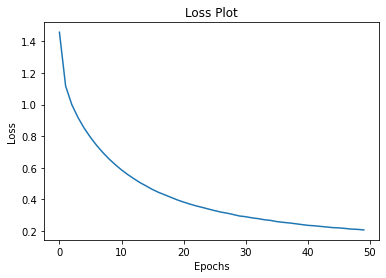

In [ ]:
#Let’s plot the error graph:

plt.plot(loss_plot)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Plot')
plt.show()

In [ ]:
def evaluate(image):
   attention_plot = np.zeros((max_length, attention_features_shape))

   hidden = decoder.reset_state(batch_size=1)
   temp_input = tf.expand_dims(load_image(image)[0], 0)
   img_tensor_val = image_features_extract_model(temp_input)
   img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
   features = encoder(img_tensor_val)
   dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
   result = []

   for i in range(max_length):
       predictions, hidden, attention_weights = decoder(dec_input, features, hidden)
       attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()
       predicted_id = tf.argmax(predictions[0]).numpy()
       result.append(tokenizer.index_word[predicted_id])

       if tokenizer.index_word[predicted_id] == '<end>':
           return result, attention_plot

       dec_input = tf.expand_dims([predicted_id], 0)
   attention_plot = attention_plot[:len(result), :]

   return result, attention_plot

In [ ]:
def plot_attention(image, result, attention_plot):
   temp_image = np.array(Image.open(image))
   fig = plt.figure(figsize=(10, 10))
   len_result = len(result)
   for l in range(len_result):
       temp_att = np.resize(attention_plot[l], (8, 8))
       ax = fig.add_subplot(len_result//2, len_result//2, l+1)
       ax.set_title(result[l])
       img = ax.imshow(temp_image)
       ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())

   plt.tight_layout()
   plt.show()

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
BELU score: 54.10822690539396
Real Caption: Two white dogs are playing in the snow
Prediction Caption: two white dogs are playing in snow


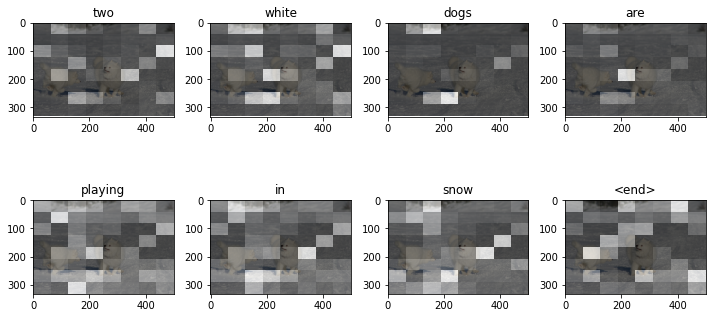

In [ ]:
# captions on the validation set
rid = np.random.randint(0, len(img_name_val))
image = '/content/Flicker8k_Dataset/2319175397_3e586cfaf8.jpg'

# real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

# remove <start> and <end> from the real_caption
real_caption = 'Two white dogs are playing in the snow'
first = real_caption.split(' ', 1)[1]
real_caption = 'Two white dogs are playing in the snow'

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

for i in real_caption:
   if i=="<unk>":
       real_caption.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result

score = sentence_bleu(reference, candidate)
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)
plot_attention(image, result, attention_plot)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
Real Caption: man wearing beret rides his bicycle on recreation trail
Prediction Caption: man in beret rides bicycle down the street


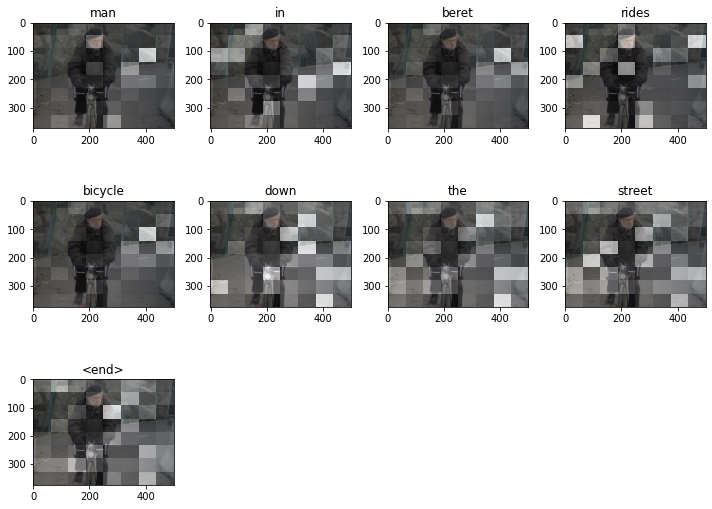

time took to Predict: 1 sec


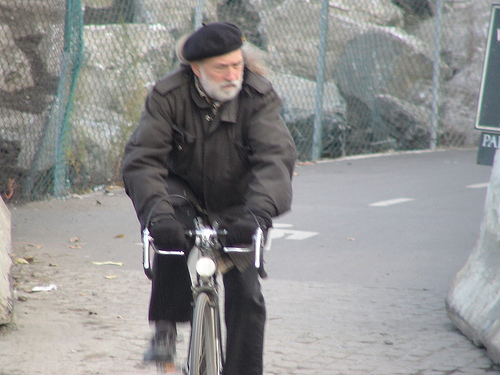

In [ ]:
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)
print(f"time took to Predict: {round(time.time()-start)} sec")

Image.open(img_name_val[rid])

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
BELU score: 6.255495473556936e-230
Real Caption: girl on bike is wearing backpack and helmet and riding through wooded area
Prediction Caption: woman wearing black shirt riding bike


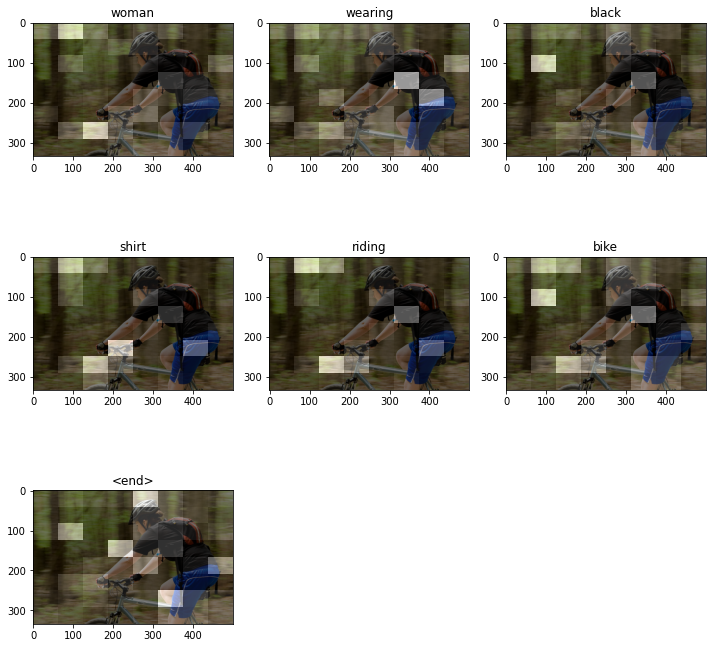

In [ ]:
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]

real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

# remove <start> and <end> from the real_caption
first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

for i in real_caption:
   if i=="<unk>":
       real_caption.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result

score = sentence_bleu(reference, candidate)
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


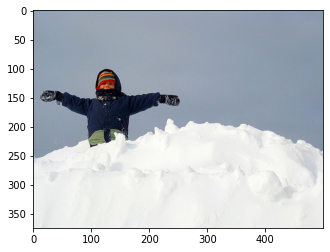

Real Caption: little kid dressed in gear is at the top of the snow mound
Prediction Caption: boy in winter clothing is standing on top of snowbank with their arms outstretched
BLEU-1 score: 26.666666666666668
BLEU-2 score: 13.801311186847082
BLEU-3 score: 1.5422526970585464e-91
BLEU-4 score: 5.541564466373977e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


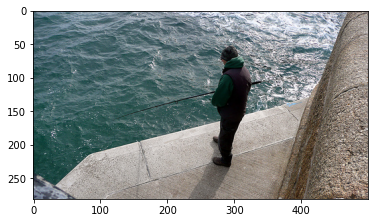

Real Caption: man fishing from the shore in the wintertime
Prediction Caption: person with long sleeve shirt
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


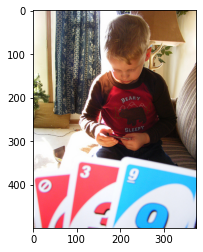

Real Caption: the boy is playing uno
Prediction Caption: three uno cards in the foreground with two sticks at the cards in and cards in the foreground with two sticks at the cards in and cards in
BLEU-1 score: 6.896551724137931
BLEU-2 score: 3.917312465865069e-153
BLEU-3 score: 1.1481437291999002e-183
BLEU-4 score: 9.336117803135293e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


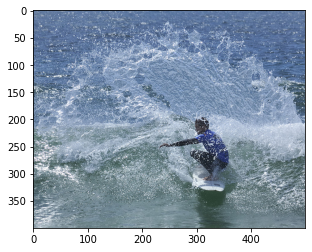

Real Caption: surfer makes big splash
Prediction Caption: man in green shorts is riding surfboard
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


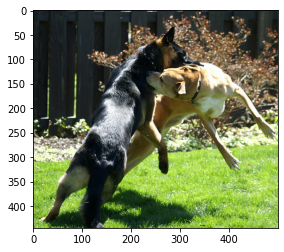

Real Caption: tan dog and black dog fighting inside fenced yard
Prediction Caption: <end>
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


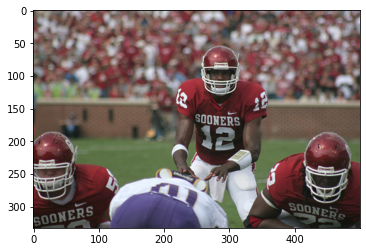

Real Caption: the sooners quarterback is waiting for the snap from his center
Prediction Caption: football players wearing red sooners jersey and white jersey and white jersey and white jersey and white jersey and white jersey and white jersey and white jersey and white jersey and white
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


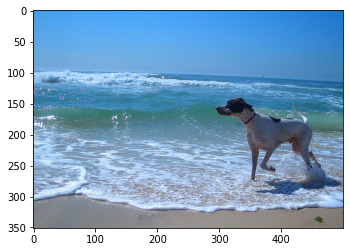

Real Caption: dog walks along beach with breaking waves
Prediction Caption: dog is wading in the ocean
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


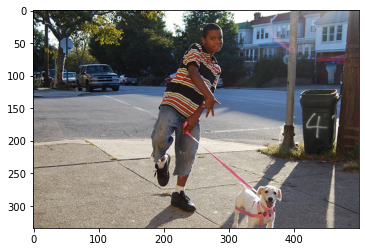

Real Caption: boy is walking small white dog down the street
Prediction Caption: an older boy walking across city
BLEU-1 score: 21.470779802151025
BLEU-2 score: 5.991755122558557e-153
BLEU-3 score: 1.3216063232004421e-183
BLEU-4 score: 1.0009379942300741e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


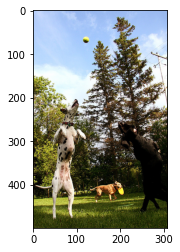

Real Caption: black and white dog are going after tennis ball
Prediction Caption: dog stands barefoot three dogs are playing with frisbee and dog jumping up to get ball in the air to get ball in the green grass
BLEU-1 score: 14.814814814814813
BLEU-2 score: 5.741433371821799e-153
BLEU-3 score: 1.4441607154633159e-183
BLEU-4 score: 1.1302704678971024e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


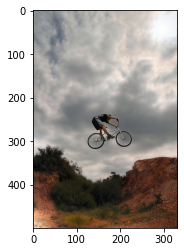

Real Caption: man on bike in midair
Prediction Caption: bicyclist is in midair on cloudy day
BLEU-1 score: 37.5
BLEU-2 score: 23.145502494313785
BLEU-3 score: 2.1032131949153637e-91
BLEU-4 score: 7.176381577237209e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


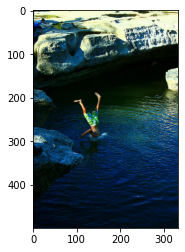

Real Caption: man jumps off some rocks into the water
Prediction Caption: man in green swimsuit entering the water headfirst into body rises above water headfirst after jumping off rock on body board
BLEU-1 score: 22.727272727272727
BLEU-2 score: 10.403129732205985
BLEU-3 score: 1.3016725248947182e-91
BLEU-4 score: 4.811208997101563e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


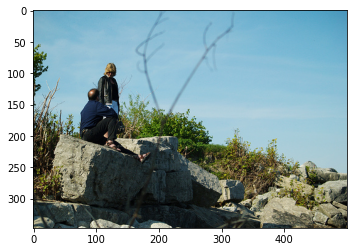

Real Caption: one person is sitting on large rock while another person is standing nearby
Prediction Caption: bald man is sitting on rock next to woman in black cap on rock next to woman in black cap on rock next to woman in black cap on rock next to
BLEU-1 score: 12.121212121212123
BLEU-2 score: 8.703882797784892
BLEU-3 score: 8.249342068276574
BLEU-4 score: 1.5270462878358646e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


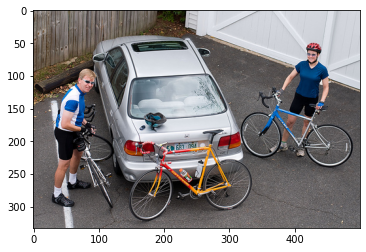

Real Caption: two bike riders standing with bikes parked at the car
Prediction Caption: three bicyclists with bicycles to her bicycle and three on the by type and bicycles to her bicycle and three on the by type and bicycles to her bicycle and three on
BLEU-1 score: 6.060606060606061
BLEU-2 score: 3.6722331233414005e-153
BLEU-3 score: 1.1044892051005175e-183
BLEU-4 score: 9.039352811507815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


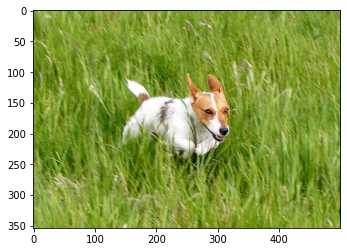

Real Caption: small dog runs through grassy field
Prediction Caption: small white dog with very long hair and white dog wearing backpack and white dog wearing backpack and white dog wearing backpack and white dog wearing backpack and white dog wearing backpack
BLEU-1 score: 6.060606060606061
BLEU-2 score: 3.6722331233414005e-153
BLEU-3 score: 1.1044892051005175e-183
BLEU-4 score: 9.039352811507815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


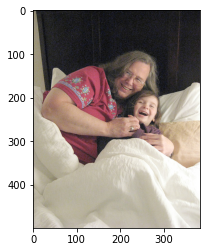

Real Caption: the woman is laying in bed with young girl
Prediction Caption: woman and two people are in bed
BLEU-1 score: 33.09363384692233
BLEU-2 score: 20.42583425999594
BLEU-3 score: 1.8560791299878595e-91
BLEU-4 score: 6.33313451367699e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


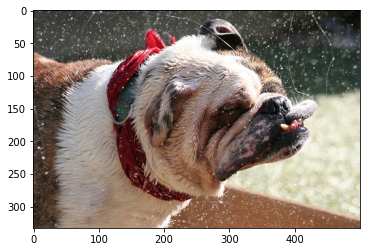

Real Caption: bulldog with red bandanna shakes off water
Prediction Caption: black dog shaking water
BLEU-1 score: 13.406400920712787
BLEU-2 score: 4.471666651098519e-153
BLEU-3 score: 1.0592485173532028e-183
BLEU-4 score: 8.166726842395623e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


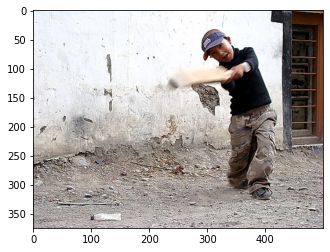

Real Caption: young boy wearing blue visor swings bat
Prediction Caption: boy in dusty alley playing
BLEU-1 score: 14.108028748176901
BLEU-2 score: 5.154827976372712e-153
BLEU-3 score: 1.2664232355128374e-183
BLEU-4 score: 9.853445011990207e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


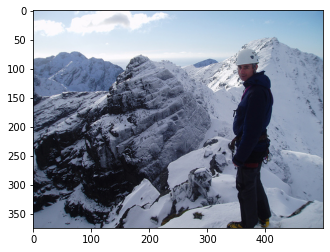

Real Caption: man is overlooking big snowy mountain
Prediction Caption: climber is standing on snowy mountaintop
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


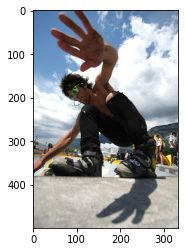

Real Caption: man wearing green glasses crouches near the camera
Prediction Caption: rollerblader pauses at the top of skate ramp
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


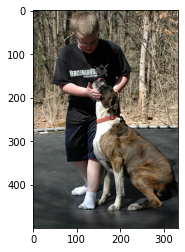

Real Caption: boy and his dog are standing on trampoline enjoying each others company
Prediction Caption: muscular dog with upturned face looking at boy in red looks on stick outside in the forest with upturned face looking at boy in red looks on stick outside in the forest
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


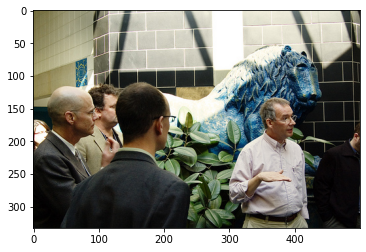

Real Caption: group of men in suits are standing in front of statue of lion
Prediction Caption: man in black and cowboy hat looks at people
BLEU-1 score: 7.40818220681718
BLEU-2 score: 3.4944905561718586e-153
BLEU-3 score: 9.508638009516205e-184
BLEU-4 score: 7.58961907326157e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


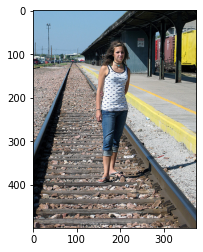

Real Caption: young woman in jeans and tank top standing on railroad tracks
Prediction Caption: girl in shorts and jean capris stands on railroad tracks
BLEU-1 score: 45.45454545454545
BLEU-2 score: 30.15113445777636
BLEU-3 score: 25.19471451241524
BLEU-4 score: 3.8719283242189534e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


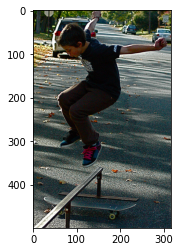

Real Caption: boy is doing stunt with his skateboard
Prediction Caption: boy doing the red shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt and white shirt
BLEU-1 score: 6.060606060606061
BLEU-2 score: 3.6722331233414005e-153
BLEU-3 score: 1.1044892051005175e-183
BLEU-4 score: 9.039352811507815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


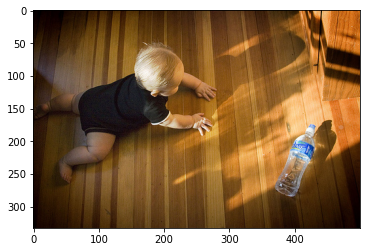

Real Caption: baby crawls on wood floor near bottle of water
Prediction Caption: small blonde hair watch
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


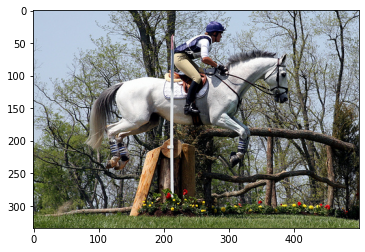

Real Caption: show jumper wearing blue helmet rides white horse over wooden fence that is decorated with red and yellow flowers
Prediction Caption: rider does jump over hurdle
BLEU-1 score: 1.9093140665447959
BLEU-2 score: 6.976301042184162e-154
BLEU-3 score: 1.713917472755573e-184
BLEU-4 score: 1.3335187715540836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


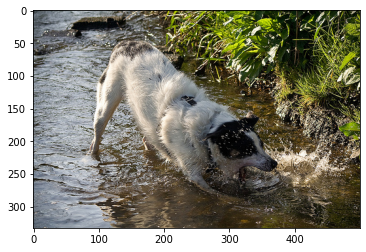

Real Caption: white dog is splashing in an outdoor stream next to grassy bank
Prediction Caption: black and white dog is splashing in shallow water
BLEU-1 score: 40.936537653899094
BLEU-2 score: 38.595337831160656
BLEU-3 score: 38.84961594004602
BLEU-4 score: 32.160943495184156
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


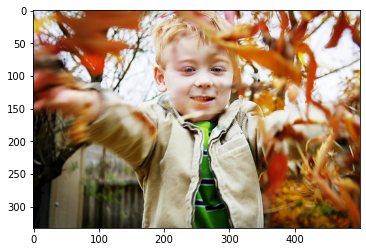

Real Caption: young boy tosses autumn leaves
Prediction Caption: little boy with green shirt and brown jacket is throwing orange fall leaves
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


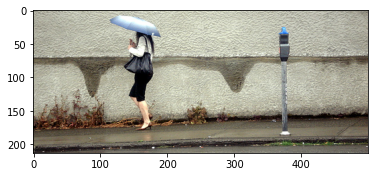

Real Caption: woman with blue umbrella stands next to parking meter
Prediction Caption: woman walking with his grey umbrella
BLEU-1 score: 32.206169703226536
BLEU-2 score: 7.33837135698786e-153
BLEU-3 score: 1.4925520509868707e-183
BLEU-4 score: 1.1077199809555582e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


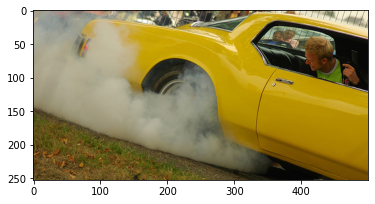

Real Caption: yellow car man in it looking to the back where steam is coming out
Prediction Caption: yellow car car its owner is creating smoke by spinning its
BLEU-1 score: 21.162043122265352
BLEU-2 score: 12.76119215161368
BLEU-3 score: 1.376528199714348e-91
BLEU-4 score: 4.90260194222537e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


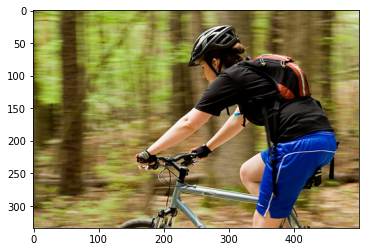

Real Caption: girl on bike is wearing backpack and helmet and riding through wooded area
Prediction Caption: woman wearing black shirt riding bike
BLEU-1 score: 18.18740767186928
BLEU-2 score: 4.144111291313716e-153
BLEU-3 score: 8.428711912321351e-184
BLEU-4 score: 6.255495473556936e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


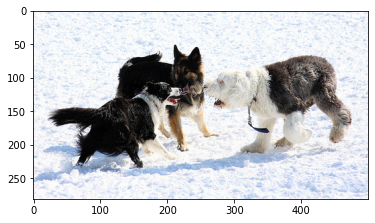

Real Caption: three dogs in the snow
Prediction Caption: three dogs meet in the snow
BLEU-1 score: 71.42857142857143
BLEU-2 score: 59.76143046671969
BLEU-3 score: 45.30661222656876
BLEU-4 score: 6.313993041533344e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


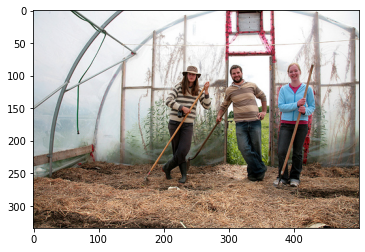

Real Caption: two women and man smile at the camera with <unk> in their hands standing in an unfinished greenhouse
Prediction Caption: people sit in large building
BLEU-1 score: 2.255588053943545
BLEU-2 score: 8.241525879469717e-154
BLEU-3 score: 2.0247542532321683e-184
BLEU-4 score: 1.5753662865272211e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


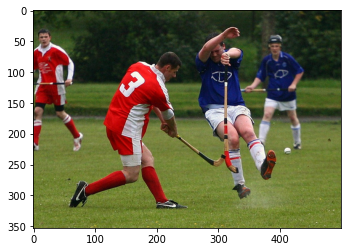

Real Caption: man in red uniform swings while another in blue uniform jumps and others look on
Prediction Caption: two men attempt to hit ball on sports
BLEU-1 score: 5.704634655917689
BLEU-2 score: 2.552826540650872e-153
BLEU-3 score: 6.801492937157117e-184
BLEU-4 score: 5.400301927028362e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


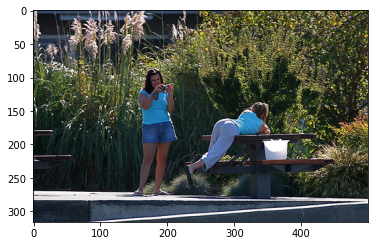

Real Caption: girl takes picture of her friend who is leaning on picnic table
Prediction Caption: one woman and girl back and another boy watches
BLEU-1 score: 8.18730753077982
BLEU-2 score: 3.862009336171134e-153
BLEU-3 score: 1.0508670198626023e-183
BLEU-4 score: 8.387826279040936e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


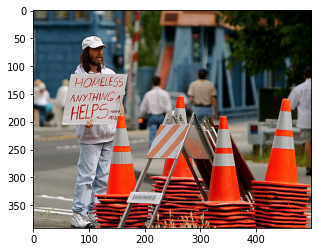

Real Caption: homeless man standing in construction site
Prediction Caption: homeless man stands on the orange cones
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


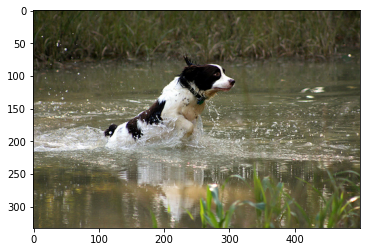

Real Caption: brown and white dog is running through the river
Prediction Caption: black and black and black and black and black and black and black and black and black and black and black and black and black and black and black and black and
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


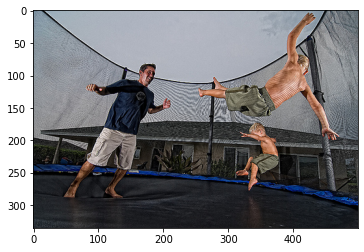

Real Caption: man and two small boys jump on trampoline
Prediction Caption: two young man and white shirt and glasses is bouncing on trampoline
BLEU-1 score: 38.46153846153847
BLEU-2 score: 25.318484177091666
BLEU-3 score: 2.2195551978722937e-91
BLEU-4 score: 7.505697654413981e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


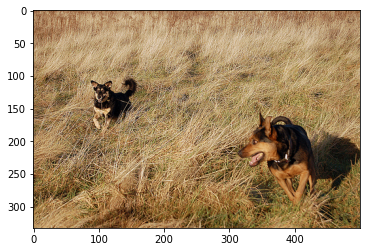

Real Caption: two dogs are running in field
Prediction Caption: two brown dogs run through field
BLEU-1 score: 42.857142857142854
BLEU-2 score: 9.765260274142007e-153
BLEU-3 score: 1.9861572195732883e-183
BLEU-4 score: 1.4740564900137074e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


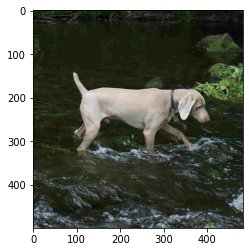

Real Caption: dog is trotting through shallow stream
Prediction Caption: light colored dog is walking through stream
BLEU-1 score: 50.0
BLEU-2 score: 26.726124191242434
BLEU-3 score: 2.2927933779232266e-91
BLEU-4 score: 7.711523862191632e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


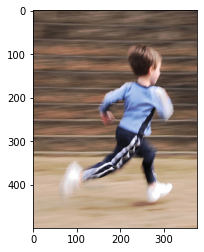

Real Caption: young boy runs
Prediction Caption: little boy in blue shirt no shirt out
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


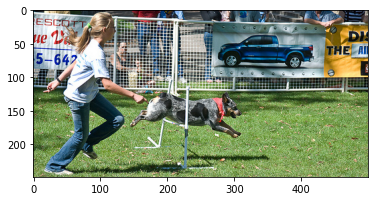

Real Caption: woman leading grey and black spotted dog in red bandanna through competition
Prediction Caption: cowboy and white dog jumps hurdle
BLEU-1 score: 13.986904558770089
BLEU-2 score: 3.9032633099964214e-153
BLEU-3 score: 8.6094597761278e-184
BLEU-4 score: 6.520501036082648e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


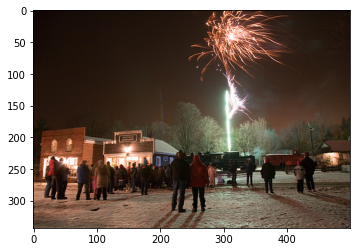

Real Caption: group of people are watching fireworks outside
Prediction Caption: people watch
BLEU-1 score: 8.786571270524224
BLEU-2 score: 2.2701381082415207e-153
BLEU-3 score: 4.855243027268271e-184
BLEU-4 score: 3.648956622645728e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


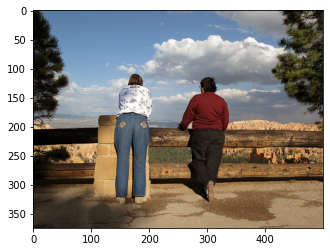

Real Caption: the two women are looking at mountains at fence
Prediction Caption: two people look at view
BLEU-1 score: 20.21768865708778
BLEU-2 score: 5.223533056060786e-153
BLEU-3 score: 1.117179715016979e-183
BLEU-4 score: 8.396161215621529e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


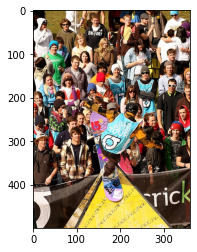

Real Caption: crowd of people watching snowboarder do tricks
Prediction Caption: many people watching
BLEU-1 score: 23.618327637050733
BLEU-2 score: 19.284283762882744
BLEU-3 score: 1.396487629292952e-91
BLEU-4 score: 4.502083459540591e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


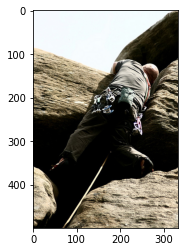

Real Caption: this picture <unk> looking up at rock climber
Prediction Caption: man climbs rock
BLEU-1 score: 9.196986029286059
BLEU-2 score: 2.743770220260171e-153
BLEU-3 score: 6.215759172786402e-184
BLEU-4 score: 4.739132419722992e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


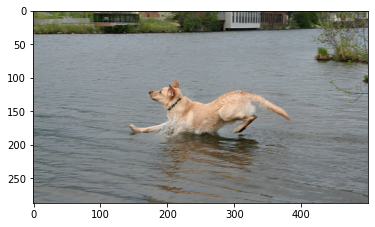

Real Caption: white dog jumps into natural water
Prediction Caption: dog running into the water
BLEU-1 score: 50.0
BLEU-2 score: 1.0547686614863434e-152
BLEU-3 score: 2.0801644027471386e-183
BLEU-4 score: 1.5319719891192392e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


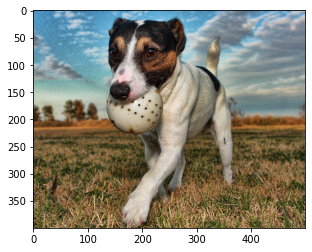

Real Caption: the dog is carrying <unk> ball outside
Prediction Caption: closeup photo of small dog with ball in front of ball in its mouth
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


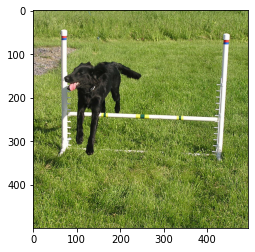

Real Caption: the black dog is jumping over the white pole in the grass
Prediction Caption: black dog jumps hurdle
BLEU-1 score: 9.86387855766426
BLEU-2 score: 7.798080701378897
BLEU-3 score: 6.254477791499576e-92
BLEU-4 score: 2.0685210321540116e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


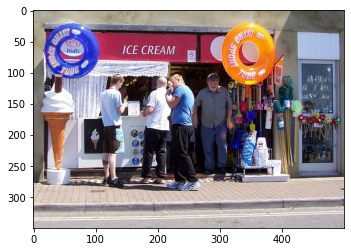

Real Caption: group outside of ice cream place decorated with giant cone two innertubes
Prediction Caption: people waiting for sale
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


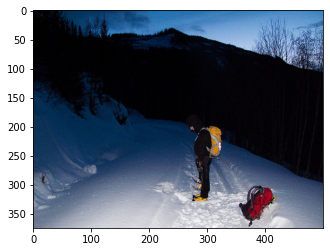

Real Caption: hiker is walking up the mountain on road
Prediction Caption: person in black
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


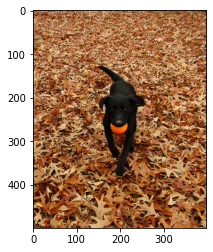

Real Caption: the black dog walks through brown leaves with an orange ball
Prediction Caption: black dog with orange ball approaches camera across dead leaves
BLEU-1 score: 54.54545454545454
BLEU-2 score: 33.02891295379082
BLEU-3 score: 2.603393988536284e-91
BLEU-4 score: 8.572734148939379e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


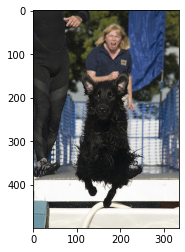

Real Caption: woman running after dog
Prediction Caption: black dog is in midair as woman behind it cheers
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


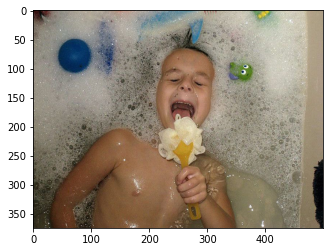

Real Caption: child sings into <unk> in the bathtub
Prediction Caption: boy blowing bubble and some green and play and bubble and play and splashing through the ground while in the bathtub
BLEU-1 score: 13.636363636363635
BLEU-2 score: 11.396057645963793
BLEU-3 score: 11.059711130636364
BLEU-4 score: 1.9496467388840192e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


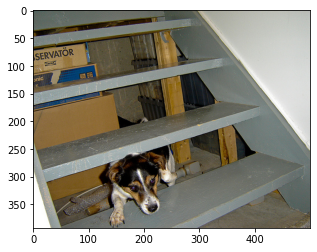

Real Caption: dog hiding under the stairs
Prediction Caption: beagle is climbing through some grey stairs
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


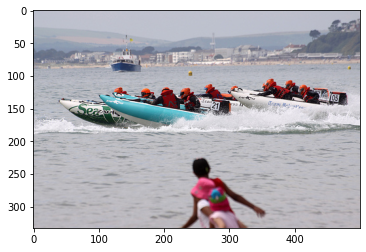

Real Caption: the group of boats races each other
Prediction Caption: group of people are out on watercraft in the background
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


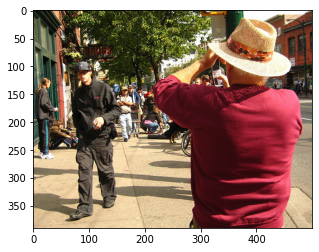

Real Caption: man in red sweatshirt and straw hat uses cellphone
Prediction Caption: man in mask is standing on bench waiting to throw cellphone
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


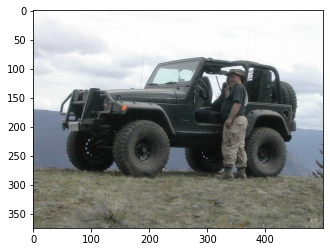

Real Caption: man next to his black jeep
Prediction Caption: man walks in dirt with green jeep
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


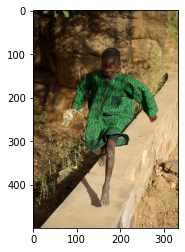

Real Caption: an african boy in large green shirt is running barefoot along wall
Prediction Caption: boy in green is running away in front of rock and water
BLEU-1 score: 38.46153846153847
BLEU-2 score: 25.318484177091666
BLEU-3 score: 2.2195551978722937e-91
BLEU-4 score: 7.505697654413981e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


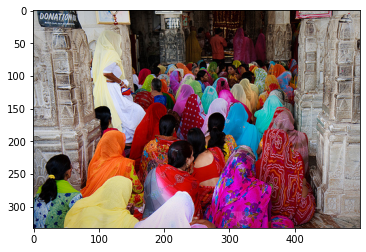

Real Caption: crowd of women wearing multiple different colors is entering stone structure
Prediction Caption: many women in colorful saris are entering stone building
BLEU-1 score: 27.145122541078788
BLEU-2 score: 16.519995491100893
BLEU-3 score: 1.650583520643603e-91
BLEU-4 score: 5.767166022187344e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


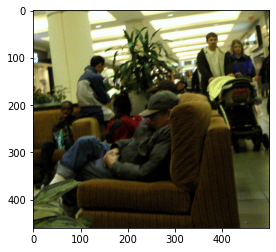

Real Caption: man is slouching on couch with people walking and sitting around him
Prediction Caption: man while in the background
BLEU-1 score: 6.1313240195240395
BLEU-2 score: 2.2402790036937483e-153
BLEU-3 score: 5.503852693656168e-184
BLEU-4 score: 4.282289549833951e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


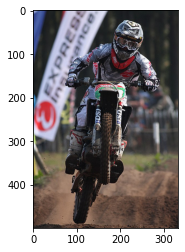

Real Caption: man in black uniform and helmet <unk> with his bike front wheel in midair
Prediction Caption: man riding dirt bike on dirt track
BLEU-1 score: 11.809163818525366
BLEU-2 score: 3.523070700364982e-153
BLEU-3 score: 7.981192761867711e-184
BLEU-4 score: 6.085166479973199e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


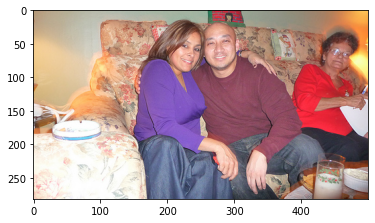

Real Caption: man and woman pose on couch
Prediction Caption: man and woman have their arms around each other while an older woman in orange sits next to them
BLEU-1 score: 15.0
BLEU-2 score: 12.565617248750868
BLEU-3 score: 12.103989676326982
BLEU-4 score: 2.101889569428303e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


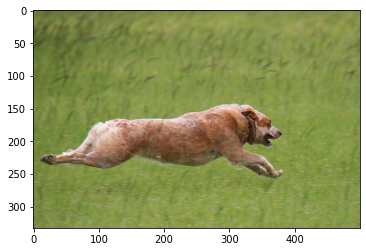

Real Caption: golden dog is running on the grass
Prediction Caption: brown dog catching brown dog in its mouth
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


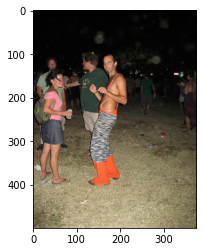

Real Caption: group of people are standing together outside
Prediction Caption: man with pink shirt with red as they dance in the blue rock
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


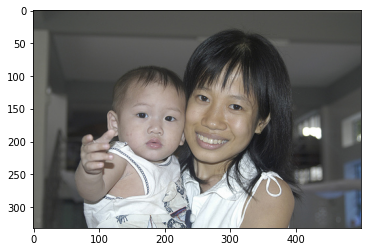

Real Caption: an asian woman holding an asian baby that is reaching toward the camera
Prediction Caption: two young asian girl with
BLEU-1 score: 5.190053731909963
BLEU-2 score: 1.896355235282911e-153
BLEU-3 score: 4.658910721669926e-184
BLEU-4 score: 3.6248798446244946e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


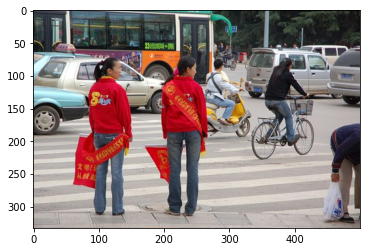

Real Caption: the backs of two asian girls wearing red tops and holding red flags
Prediction Caption: two people in red jackets with red sashes standing on the street
BLEU-1 score: 30.769230769230766
BLEU-2 score: 8.274286134223026e-153
BLEU-3 score: 1.798215142829991e-183
BLEU-4 score: 1.3568676344828118e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


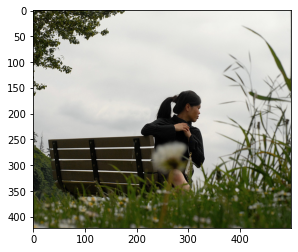

Real Caption: girl sitting on bench amongst the grass
Prediction Caption: girl in white shirt is standing on wooden bench
BLEU-1 score: 30.0
BLEU-2 score: 8.170202920075766e-153
BLEU-3 score: 1.7846088208682726e-183
BLEU-4 score: 1.3483065280626045e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


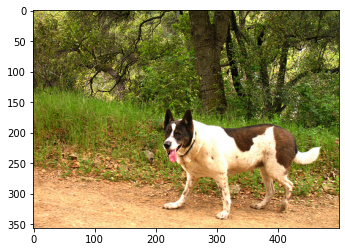

Real Caption: the white and brown dog stands in front of the woods with its tongue hanging out
Prediction Caption: two dogs are running away from small black dog that is standing in the air that muddy hole in front of trees
BLEU-1 score: 21.73913043478261
BLEU-2 score: 14.058038927888331
BLEU-3 score: 12.362009031012416
BLEU-4 score: 2.1391619003311795e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


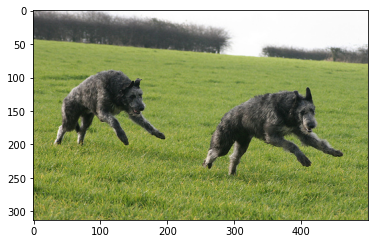

Real Caption: two grey dogs running in green grass
Prediction Caption: two large gray dogs running through grassy field
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


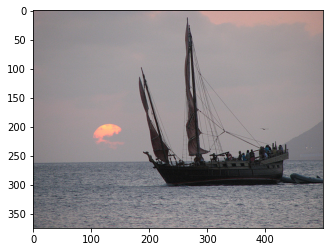

Real Caption: sailboat in the water
Prediction Caption: boat sailing past boat and big city scene
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


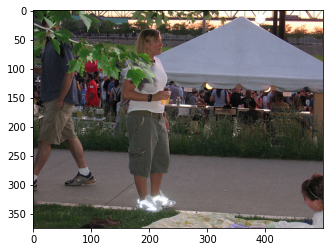

Real Caption: person standing on the sidewalk near large gathering of people at tent
Prediction Caption: woman standing with drink in front of crowd
BLEU-1 score: 15.922918012750872
BLEU-2 score: 5.038498475779542e-153
BLEU-3 score: 1.168632815958936e-183
BLEU-4 score: 8.962731118674859e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


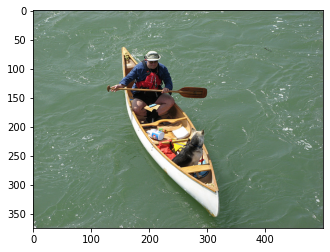

Real Caption: the man holds wooden paddle in canoe with his dog
Prediction Caption: man and dog in canoe on an black dog in canoe on an black dog in canoe on an black dog in canoe on an black dog in canoe on an black
BLEU-1 score: 12.121212121212123
BLEU-2 score: 6.154574548966637
BLEU-3 score: 9.499968196054682e-92
BLEU-4 score: 3.7005922416742967e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


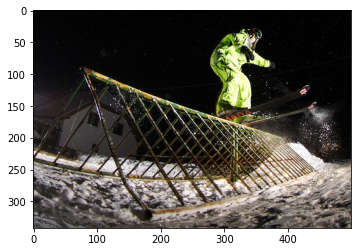

Real Caption: person on skis on rail at night
Prediction Caption: skier in electric green on the edge of ramp made of ramp made of ramp made of ramp made of ramp made of ramp made of ramp made of ramp made of
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


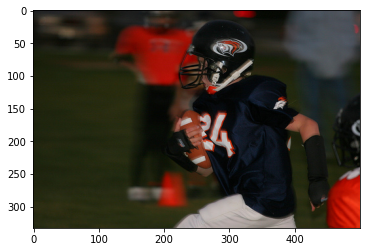

Real Caption: man in football uniform is running with football during game
Prediction Caption: football player running with football under his arm
BLEU-1 score: 39.77063630286087
BLEU-2 score: 29.82797722714566
BLEU-3 score: 25.81920660337923
BLEU-4 score: 3.879234451140231e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


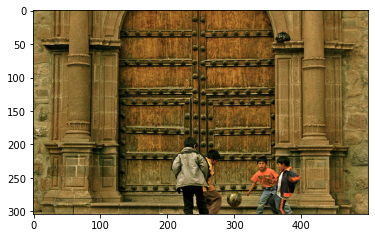

Real Caption: four boys playing game with soccer ball in front of large set of ornate doors
Prediction Caption: some kids it is playing with ball in front of very large medieval box with ball in front of very large medieval box with ball in front of very large medieval box
BLEU-1 score: 24.242424242424242
BLEU-2 score: 15.075567228888179
BLEU-3 score: 14.120975112436362
BLEU-4 score: 8.361295892194455
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


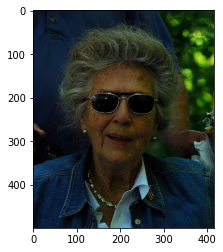

Real Caption: an old woman in sunglasses and jean jacket smiles for the camera
Prediction Caption: an elderly person
BLEU-1 score: 3.3833820809153177
BLEU-2 score: 1.0093766553321569e-153
BLEU-3 score: 2.286650010940928e-184
BLEU-4 score: 1.7434293862051596e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


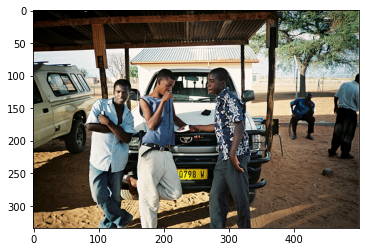

Real Caption: some young boys hang out around their car
Prediction Caption: three young men lean on purple outfit standing on the front
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


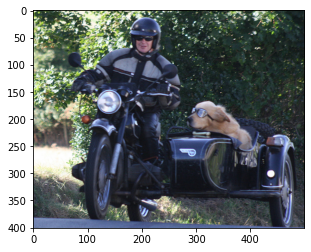

Real Caption: man is riding motorcycle with his dog in the <unk> seat
Prediction Caption: two motorcycles motorcycles each other
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


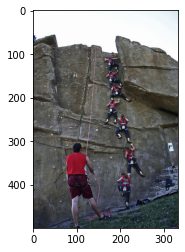

Real Caption: group of people are rock climbing on rock climbing wall
Prediction Caption: seven climbers are ascending rock face whilst spinning set of rock face
BLEU-1 score: 30.769230769230766
BLEU-2 score: 8.274286134223026e-153
BLEU-3 score: 1.798215142829991e-183
BLEU-4 score: 1.3568676344828118e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


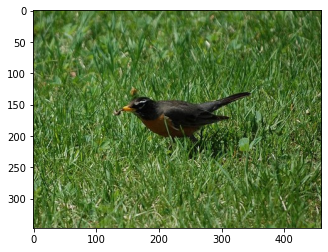

Real Caption: brown bird is standing still in grassy field
Prediction Caption: black bird with black spots is eating while running through field of grass
BLEU-1 score: 21.428571428571423
BLEU-2 score: 6.905081759897607e-153
BLEU-3 score: 1.6132609611386312e-183
BLEU-4 score: 1.239528818333946e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


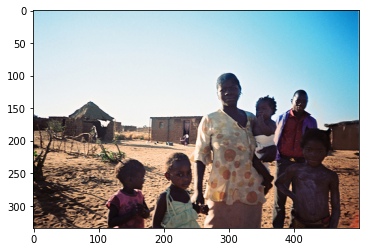

Real Caption: family standing in small village
Prediction Caption: two young lady and boy and another in sunny park
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


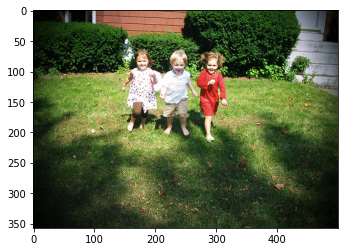

Real Caption: three little children in grassy yard running towards the camera
Prediction Caption: group of people one holding hands
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


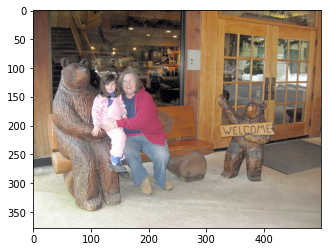

Real Caption: woman and child sitting on bench beside wooden bear carving
Prediction Caption: woman holds small boy on small boy in front of store
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


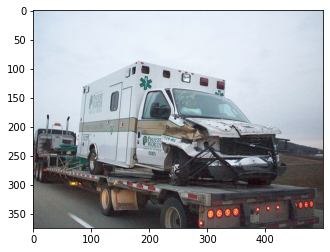

Real Caption: the ambulance on the <unk> truck was in collision
Prediction Caption: damaged ambulance is being towed by large tow truck
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


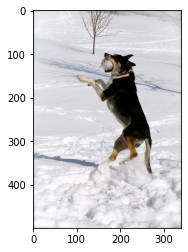

Real Caption: black dog catches ball in the snow
Prediction Caption: dog catching the other in front of some snow
BLEU-1 score: 40.0
BLEU-2 score: 9.434137710479516e-153
BLEU-3 score: 1.9454705288851736e-183
BLEU-4 score: 1.4488496539373276e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


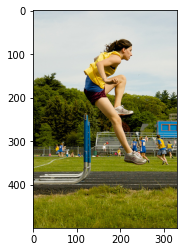

Real Caption: girl in yellow shirt jumping over hurdle
Prediction Caption: girl in yellow tank top jumping blue hurdle with people in the air next to touch ground and reach the gate
BLEU-1 score: 22.727272727272727
BLEU-2 score: 14.712247158412492
BLEU-3 score: 12.891350266565798
BLEU-4 score: 2.2152263824902215e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


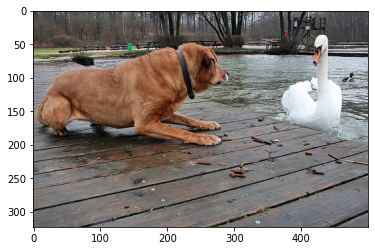

Real Caption: brown dog on dock faces white swan in the water
Prediction Caption: tan dog is looking at swan in the surface
BLEU-1 score: 40.0
BLEU-2 score: 29.81423969999719
BLEU-3 score: 25.92550634024553
BLEU-4 score: 3.965294799986402e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


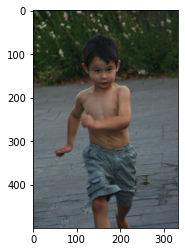

Real Caption: shirtless dark haired boy in gray shorts is running
Prediction Caption: little boy smiles and no shirt is running outdoors
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


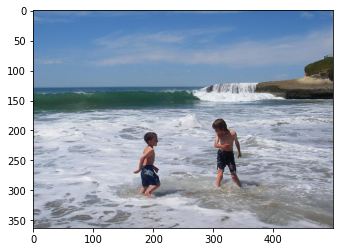

Real Caption: two boys play in the ocean
Prediction Caption: two young boys play in shallow waves against brilliant blue sky
BLEU-1 score: 33.33333333333333
BLEU-2 score: 24.618298195866544
BLEU-3 score: 21.614978940479492
BLEU-4 score: 3.4077295621678845e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


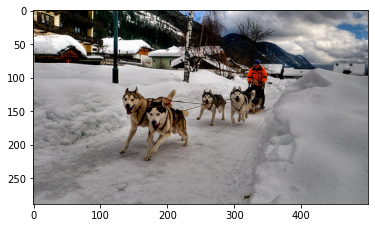

Real Caption: dog sledding team pulling man wearing bright orange jacket in the snow
Prediction Caption: dogs lead sled with another dog with dog is in the snow
BLEU-1 score: 30.769230769230766
BLEU-2 score: 22.64554068289192
BLEU-3 score: 19.978910945001886
BLEU-4 score: 3.191385619211647e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


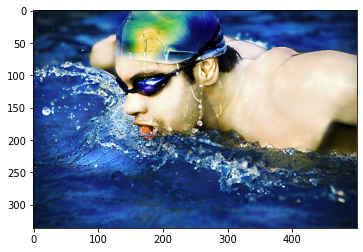

Real Caption: the swimmer is wearing green and yellow hat and goggles
Prediction Caption: two people swimming cap is wearing an orange and white swimming cap is wearing an orange and white swimming cap is wearing an orange and white swimming cap is wearing an orange
BLEU-1 score: 12.121212121212123
BLEU-2 score: 6.154574548966637
BLEU-3 score: 9.499968196054682e-92
BLEU-4 score: 3.7005922416742967e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


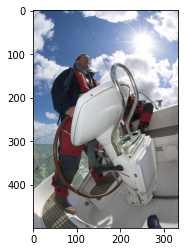

Real Caption: man navigating watercraft under partly cloudy skies
Prediction Caption: man in boat that is steering his ship out at sea
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


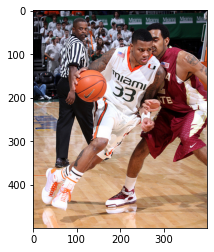

Real Caption: basketball player dribbles the ball while another blocks him and an official looks on
Prediction Caption: the guard drives towards the basket during college basketball game
BLEU-1 score: 13.84182521267043
BLEU-2 score: 4.842246805851196e-153
BLEU-3 score: 1.1691060350390872e-183
BLEU-4 score: 9.056777564992551e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


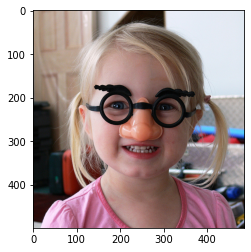

Real Caption: little girl is smiling whilst wearing fake nose and glasses
Prediction Caption: blond girl earring groucho marx glasses
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


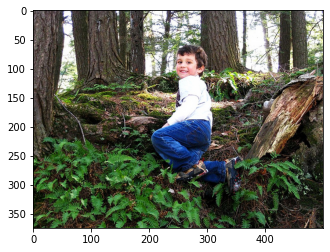

Real Caption: little boy in blue jeans climbs small incline in the woods and turns around to smile
Prediction Caption: boy wearing white shirt climbs on forest hill
BLEU-1 score: 10.209462756353926
BLEU-2 score: 3.230586409804061e-153
BLEU-3 score: 7.493044428685423e-184
BLEU-4 score: 5.746727420065187e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


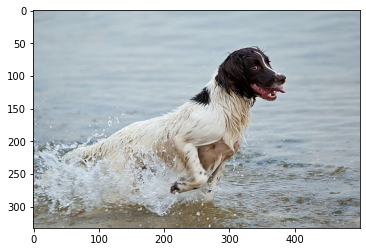

Real Caption: wet dog emerges from deep water
Prediction Caption: large black and white dog leaping into the water to catch ball in the water to catch ball in the water to catch ball in the water to catch ball in the
BLEU-1 score: 6.060606060606061
BLEU-2 score: 3.6722331233414005e-153
BLEU-3 score: 1.1044892051005175e-183
BLEU-4 score: 9.039352811507815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


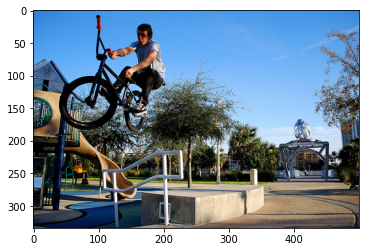

Real Caption: cyclist is performing jump over white railing
Prediction Caption: boy is jumping rail on his bicycle
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


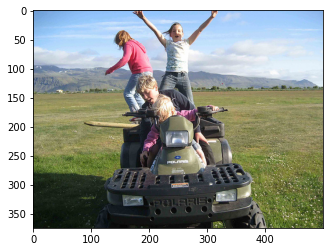

Real Caption: several children playing on polaris vehicle outdoors
Prediction Caption: boy playing on four wheeler in the green grass in park
BLEU-1 score: 16.666666666666668
BLEU-2 score: 12.309149097933275
BLEU-3 score: 1.4399259176082162e-91
BLEU-4 score: 5.233427736988301e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


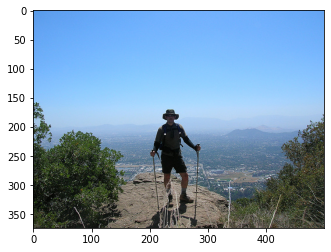

Real Caption: hiking man stands on cliff overlooking city
Prediction Caption: man hikes on dirt path high above city
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


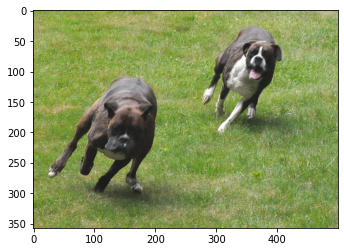

Real Caption: black and white dog chases bigger dog across the grass
Prediction Caption: black and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and
BLEU-1 score: 9.09090909090909
BLEU-2 score: 7.5377836144440895
BLEU-3 score: 7.567243195322369
BLEU-4 score: 1.4210766955338567e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


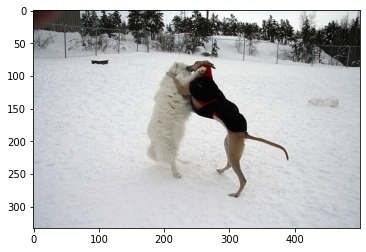

Real Caption: the dogs play in the snow on hind legs
Prediction Caption: two dogs fighting over each other in area
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


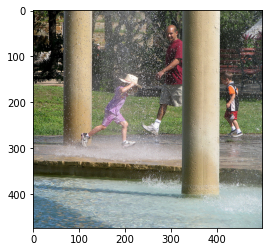

Real Caption: man and two toddlers get <unk> as they pass an ornamental fountain
Prediction Caption: young girl is playing in black shirt and black shirt and black shirt is running in the water
BLEU-1 score: 5.263157894736841
BLEU-2 score: 3.422121424610076e-153
BLEU-3 score: 1.0587186866676174e-183
BLEU-4 score: 8.726094729337945e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


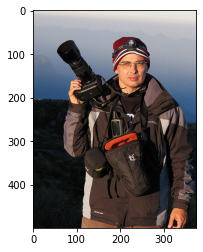

Real Caption: man in gear holding large camera
Prediction Caption: man and out at sunset
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


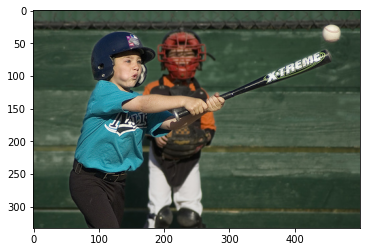

Real Caption: little boy in teal uniform swinging baseball bat
Prediction Caption: boy hits baseball with the bat
BLEU-1 score: 37.1519099892935
BLEU-2 score: 8.465288316962106e-153
BLEU-3 score: 1.7217557990773525e-183
BLEU-4 score: 1.2778269941762074e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


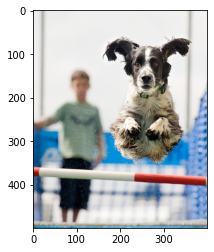

Real Caption: dog is jumping over red and white bar
Prediction Caption: black and white dog wearing white and white and white and white and white and white and white and white and white and white and white and white and white and white
BLEU-1 score: 9.09090909090909
BLEU-2 score: 5.33001790889026
BLEU-3 score: 8.714460994874503e-92
BLEU-4 score: 3.4437891216575777e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


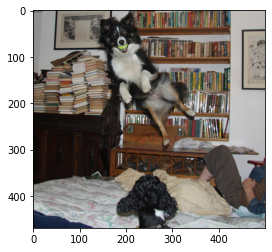

Real Caption: the black and white dog jumps with tennis ball in its mouth
Prediction Caption: dog jumps on bed and catches green toy in mouth open
BLEU-1 score: 41.66666666666667
BLEU-2 score: 19.462473604038074
BLEU-3 score: 1.895492853499074e-91
BLEU-4 score: 6.58068698831898e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


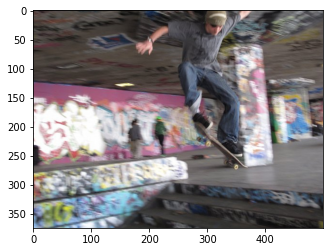

Real Caption: man performing trick on skateboard at graffiti covered skate park
Prediction Caption: young man in camouflage pants and red shirt and red shirt and red shirt and red shirt and red shirt and red shirt and red shirt and red shirt and red shirt
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


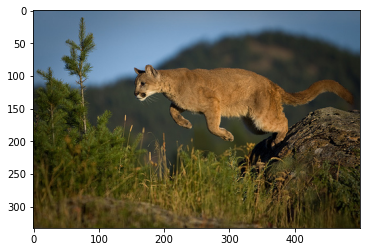

Real Caption: <unk> pouncing off rock
Prediction Caption: tiger leaping off rock
BLEU-1 score: 40.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


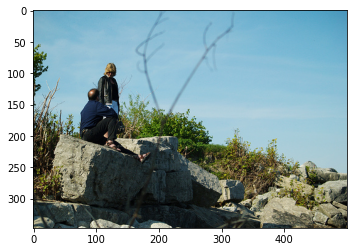

Real Caption: one person is sitting on large rock while another person is standing nearby
Prediction Caption: bald man is sitting on rock next to woman in black cap on rock next to woman in black cap on rock next to woman in black cap on rock next to
BLEU-1 score: 12.121212121212123
BLEU-2 score: 8.703882797784892
BLEU-3 score: 8.249342068276574
BLEU-4 score: 1.5270462878358646e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


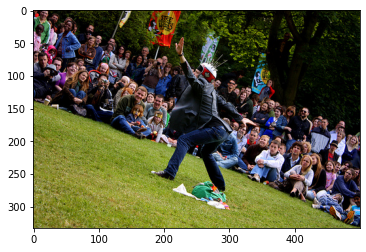

Real Caption: person wearing black coat and helmet with spiky things is posing on the lawn in front of crowd of people
Prediction Caption: performer putting on an act in front of large crowd of people
BLEU-1 score: 31.427064207730908
BLEU-2 score: 24.726681888309713
BLEU-3 score: 20.905008485847063
BLEU-4 score: 3.0297229650959254e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


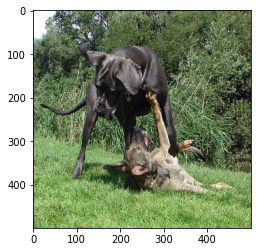

Real Caption: big grey dog wearing chain collar has smaller brown dog pinned down
Prediction Caption: the dog is running on the grass
BLEU-1 score: 7.581633246407919
BLEU-2 score: 3.1987476604776096e-153
BLEU-3 score: 8.324006713297918e-184
BLEU-4 score: 6.570351225189682e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


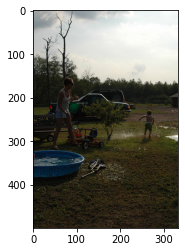

Real Caption: woman watches child play near small pool
Prediction Caption: child is running away from the water park
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


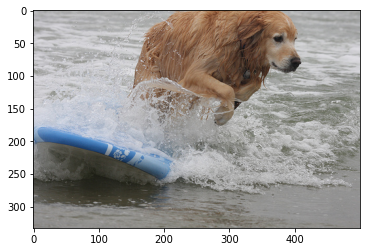

Real Caption: golden retriever jumping from board on an ocean beach
Prediction Caption: dog is on blue shorts riding the water
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


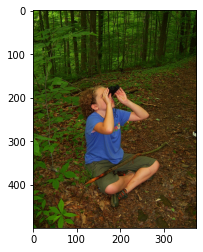

Real Caption: child in blue shirt sitting on forest floor looking through binoculars
Prediction Caption: child sitting in the woods looking up with binoculars
BLEU-1 score: 45.241870901797974
BLEU-2 score: 9.54394152284548e-153
BLEU-3 score: 1.8822105872720347e-183
BLEU-4 score: 1.3861855791380655e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


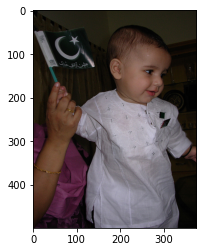

Real Caption: baby in white garment holds flag with <unk> moon and star
Prediction Caption: baby in white outfit holding black and white gown waves to dance
BLEU-1 score: 30.769230769230766
BLEU-2 score: 22.64554068289192
BLEU-3 score: 19.978910945001886
BLEU-4 score: 3.191385619211647e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


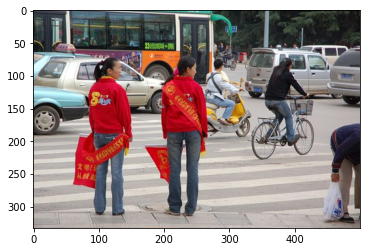

Real Caption: the backs of two asian girls wearing red tops and holding red flags
Prediction Caption: two people in red jackets with red sashes standing on the street
BLEU-1 score: 30.769230769230766
BLEU-2 score: 8.274286134223026e-153
BLEU-3 score: 1.798215142829991e-183
BLEU-4 score: 1.3568676344828118e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


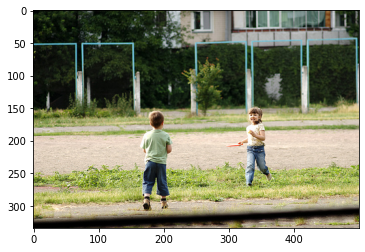

Real Caption: little girl and boy play frisbee together in grassy area
Prediction Caption: two children playing in field
BLEU-1 score: 8.556951983876534
BLEU-2 score: 3.126561213214481e-153
BLEU-3 score: 7.68124520511009e-184
BLEU-4 score: 5.9764165035645785e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


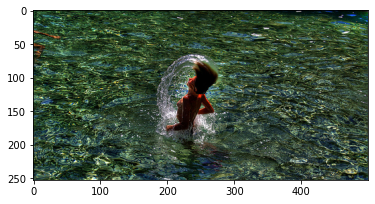

Real Caption: person emerges from pool of water the water cascading from their hair
Prediction Caption: woman is in the water
BLEU-1 score: 12.262648039048077
BLEU-2 score: 9.49860632712725
BLEU-3 score: 8.261929215253368e-92
BLEU-4 score: 2.788399004651202e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


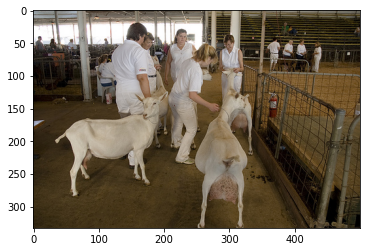

Real Caption: group of females in white suits are in petting zoo with two goats
Prediction Caption: group of people in white and playing with something in an indoor arena with dressed in white
BLEU-1 score: 33.33333333333333
BLEU-2 score: 19.80295085953348
BLEU-3 score: 1.9153196985619676e-91
BLEU-4 score: 6.637998815821916e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


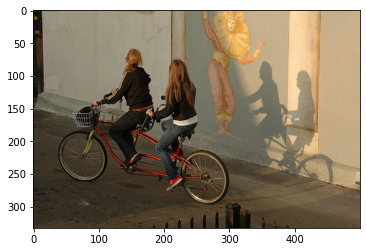

Real Caption: the two girls ride together on the bicycle while <unk>
Prediction Caption: two women on their bike beside wall painting eating with house
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


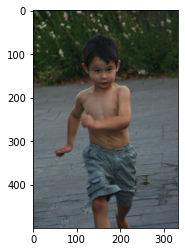

Real Caption: small boy in blue shorts running down sidewalk with flowers in the background
Prediction Caption: little boy smiles and no shirt is running outdoors
BLEU-1 score: 14.816364413634359
BLEU-2 score: 4.941955938122807e-153
BLEU-3 score: 1.1706506563935077e-183
BLEU-4 score: 9.025629002083406e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


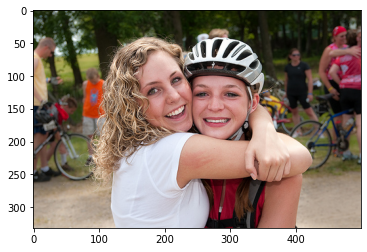

Real Caption: two teenage girls hugging one wearing bicycle helmet with cyclists in the background
Prediction Caption: group of people hugging
BLEU-1 score: 4.037930359893108
BLEU-2 score: 1.3468401129116942e-153
BLEU-3 score: 3.1903952240336635e-184
BLEU-4 score: 2.459770855197576e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


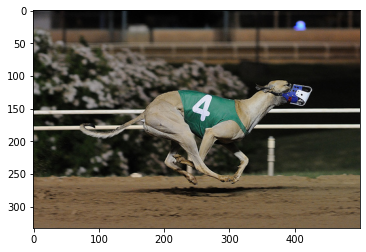

Real Caption: greyhound sporting number is racing
Prediction Caption: large greyhound dog wearing
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


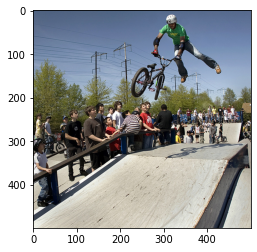

Real Caption: bicycle stunt person midair performing trick with fans watching
Prediction Caption: man on dirt bike performing stunt in the air
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


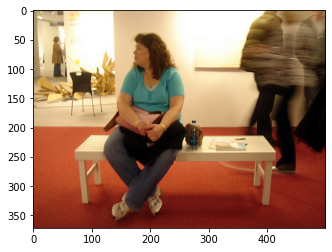

Real Caption: woman sitting alone with drink on bench as people walk by
Prediction Caption: the lady with brown shirt sitting on white bench
BLEU-1 score: 36.193496721438386
BLEU-2 score: 8.536360807345964e-153
BLEU-3 score: 1.760334530221513e-183
BLEU-4 score: 1.3109733799909448e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


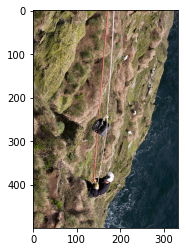

Real Caption: person repelling on the side of cliff face
Prediction Caption: extreme climbing over ocean
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


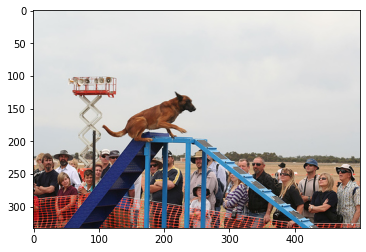

Real Caption: large brown dog walks up blue staircase
Prediction Caption: many people are watching man is watching man is watching man is watching man is watching man is watching man is watching man is watching man is watching man is watching man
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


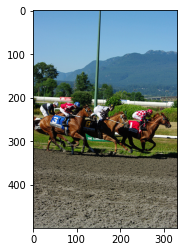

Real Caption: horses with jockeys participate in race
Prediction Caption: professional horse race
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


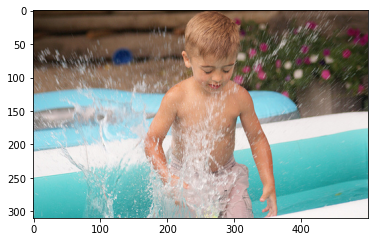

Real Caption: boy in an inflatable pool is being splashed with water
Prediction Caption: boy is playing in pool
BLEU-1 score: 34.227807935506135
BLEU-2 score: 6.253122426428973e-153
BLEU-3 score: 1.1642590608814067e-183
BLEU-4 score: 8.451929273732148e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


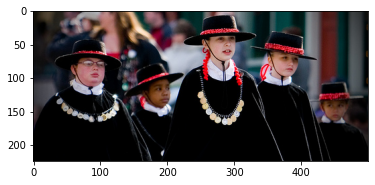

Real Caption: some children in black robes and black and red hats
Prediction Caption: five girls dressed alike
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


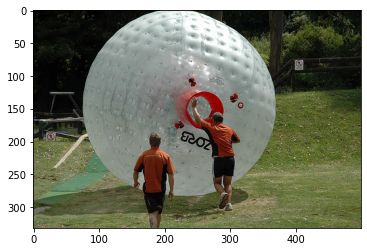

Real Caption: the men are on hill with giant white ball
Prediction Caption: two men <unk> low over the ball
BLEU-1 score: 33.09363384692233
BLEU-2 score: 8.061224930331203e-153
BLEU-3 score: 1.683950142240867e-183
BLEU-4 score: 1.258141043412406e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


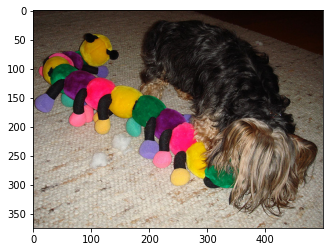

Real Caption: black and tan dog plays with centipede toy
Prediction Caption: black short dog tags nap on the ground
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


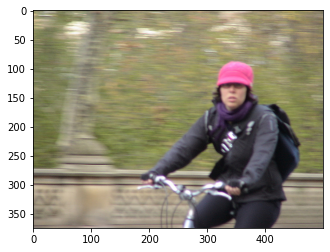

Real Caption: woman wearing black clothes purple scarf and pink hat is riding bike
Prediction Caption: woman wearing red clothing and shirt and riding bike in the park
BLEU-1 score: 38.46153846153847
BLEU-2 score: 25.318484177091666
BLEU-3 score: 2.2195551978722937e-91
BLEU-4 score: 7.505697654413981e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


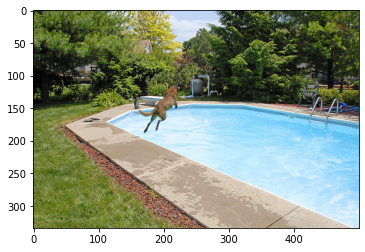

Real Caption: brown dog jumping into the pool
Prediction Caption: yellow dog into the pool
BLEU-1 score: 66.66666666666666
BLEU-2 score: 51.63977794943222
BLEU-3 score: 44.3785003431675
BLEU-4 score: 6.206021746903507e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


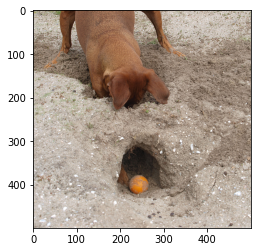

Real Caption: brown dog digs in the sand for an orange ball
Prediction Caption: brown dog that is playing with water
BLEU-1 score: 19.470019576785123
BLEU-2 score: 14.717951377637847
BLEU-3 score: 1.4503816601791856e-91
BLEU-4 score: 5.050205928624139e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


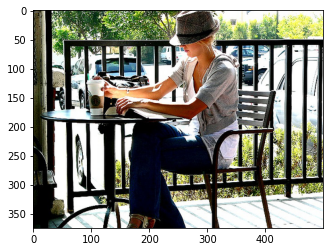

Real Caption: girl is reading while drinking <unk> coffee
Prediction Caption: woman in hat sits reading and drinking coffee
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


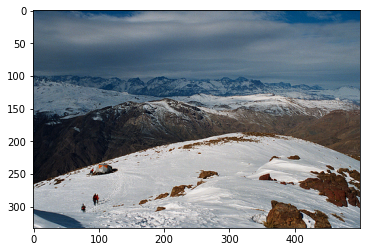

Real Caption: the brown mountains have snow on them and there are clouds in the sky
Prediction Caption: snow covered landscape is standing on mountaintop
BLEU-1 score: 11.809163818525366
BLEU-2 score: 3.523070700364982e-153
BLEU-3 score: 7.981192761867711e-184
BLEU-4 score: 6.085166479973199e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


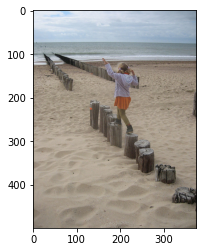

Real Caption: young girl is walking on stumps on the beach next to the ocean
Prediction Caption: little girl is walking along line of logs on sandy beach
BLEU-1 score: 38.33518394288847
BLEU-2 score: 25.323389070344454
BLEU-3 score: 21.263591180308822
BLEU-4 score: 3.315136523964873e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


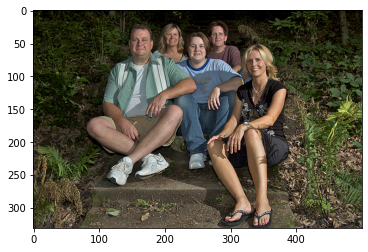

Real Caption: these five people are seated on steps outdoors
Prediction Caption: group of people sit on the steps
BLEU-1 score: 37.5
BLEU-2 score: 9.134564559628536e-153
BLEU-3 score: 1.9081654987219002e-183
BLEU-4 score: 1.4256605770826505e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


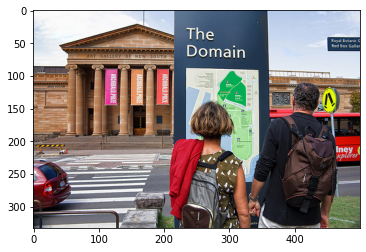

Real Caption: two people read sign in front of museum
Prediction Caption: two women and woman are standing in front of an art gallery looking at map
BLEU-1 score: 25.0
BLEU-2 score: 18.25741858350554
BLEU-3 score: 16.331467571556445
BLEU-4 score: 2.697887185123482e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


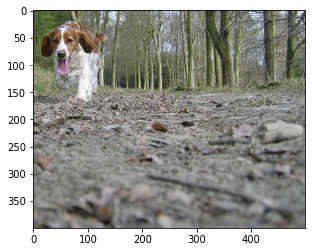

Real Caption: brown and white dog is walking on woodland path
Prediction Caption: shaggy dog walks on dirt road in forest in forest in forest in forest in forest in forest in forest in forest in forest in forest in forest in forest in forest
BLEU-1 score: 6.060606060606061
BLEU-2 score: 3.6722331233414005e-153
BLEU-3 score: 1.1044892051005175e-183
BLEU-4 score: 9.039352811507815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


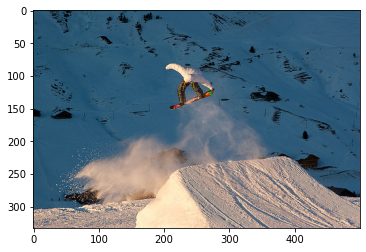

Real Caption: snowboarder jumps off of ramp in the snowy mountains
Prediction Caption: the man is riding his bike through hole and rock
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


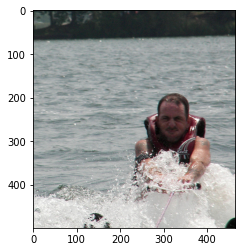

Real Caption: man waterskies
Prediction Caption: man holds his boogie board in the water
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


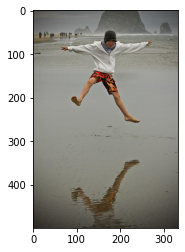

Real Caption: little kid jumps up into the air above the ocean
Prediction Caption: child jumping in the air over the watery beach
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


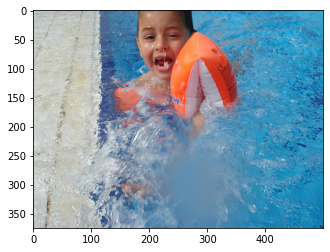

Real Caption: little boy is wearing water wings in swimming pool
Prediction Caption: child in pool
BLEU-1 score: 14.325239843009504
BLEU-2 score: 3.021962810936394e-153
BLEU-3 score: 5.959770796448675e-184
BLEU-4 score: 4.38917323538109e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


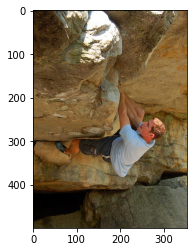

Real Caption: young man in blue shirt climbs up rock face with no ropes
Prediction Caption: man is rock climbing equipment
BLEU-1 score: 12.262648039048077
BLEU-2 score: 3.168232950523297e-153
BLEU-3 score: 6.776037495668201e-184
BLEU-4 score: 5.092529201164552e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


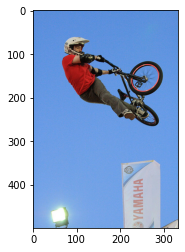

Real Caption: the man wearing red shirt is performing an aerial stunt on bicycle
Prediction Caption: biker wearing helmet
BLEU-1 score: 3.3833820809153177
BLEU-2 score: 1.0093766553321569e-153
BLEU-3 score: 2.286650010940928e-184
BLEU-4 score: 1.7434293862051596e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


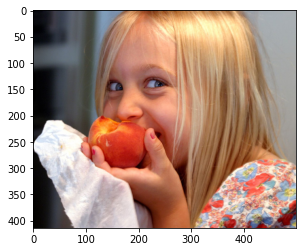

Real Caption: little girl enjoys eating peach
Prediction Caption: girl eats peach
BLEU-1 score: 38.94003915357025
BLEU-2 score: 8.214546595247417e-153
BLEU-3 score: 1.620033665776733e-183
BLEU-4 score: 1.1931009847695213e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


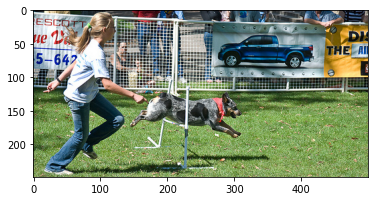

Real Caption: dog and his trainer at challenge
Prediction Caption: cowboy and white dog jumps hurdle
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


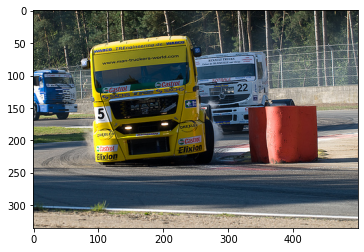

Real Caption: yellow truck with <unk> <unk> leads white truck and blue truck down the road
Prediction Caption: large yellow vehicle leads the street the number five leads two rocket net
BLEU-1 score: 21.428571428571423
BLEU-2 score: 6.905081759897607e-153
BLEU-3 score: 1.6132609611386312e-183
BLEU-4 score: 1.239528818333946e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


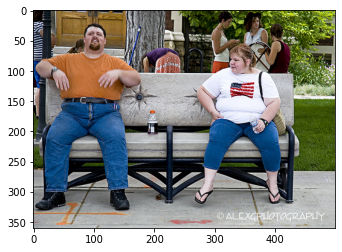

Real Caption: an overweight man makes arm gestures on park bench and woman watches him
Prediction Caption: man and woman sitting on bench
BLEU-1 score: 30.31234611978214
BLEU-2 score: 14.642254256088552
BLEU-3 score: 1.1341412083064521e-91
BLEU-4 score: 3.718347556444741e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


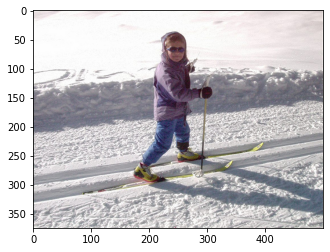

Real Caption: girl on skis in snow
Prediction Caption: girl in blue shirt is skiing
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


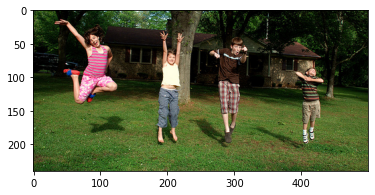

Real Caption: two boys and two girls jump as they have their photo taken
Prediction Caption: the skinny girl is holding shot
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


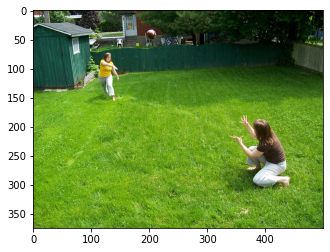

Real Caption: the woman in yellow is throwing the football to the woman in brown
Prediction Caption: two little boy and them
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


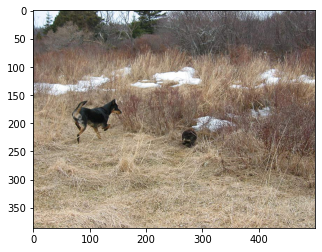

Real Caption: black dog running through grassy area
Prediction Caption: two large black dog playing in grass
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


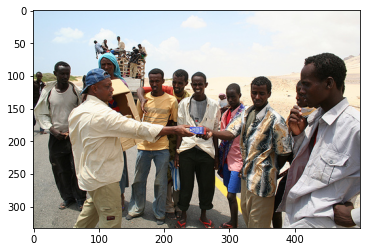

Real Caption: man wearing backwards blue cap hands something to one man in line of men
Prediction Caption: group of men are standing on desert road
BLEU-1 score: 12.750076016387393
BLEU-2 score: 9.562557012290547
BLEU-3 score: 9.909183413243782e-92
BLEU-4 score: 3.4939917753558776e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


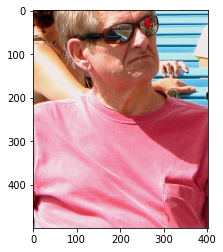

Real Caption: an old man sitting down watching something
Prediction Caption: man in sunglasses in pink shirt
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


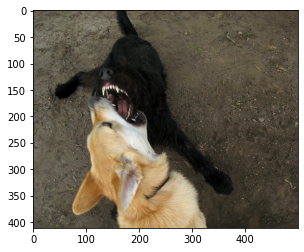

Real Caption: two dogs are bearing their teeth at each other
Prediction Caption: two dogs one jumping on its wings
BLEU-1 score: 22.062422564614888
BLEU-2 score: 16.677623835883093
BLEU-3 score: 1.6434977345885395e-91
BLEU-4 score: 5.722633035689358e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


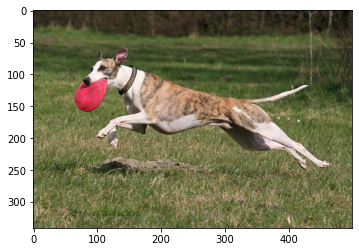

Real Caption: brown and white dog is jumping with red frisbee in its mouth
Prediction Caption: brown and white dog leaps with disc in its mouth
BLEU-1 score: 66.40732482052817
BLEU-2 score: 55.062044940236795
BLEU-3 score: 48.48222010584551
BLEU-4 score: 32.03558799120807
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


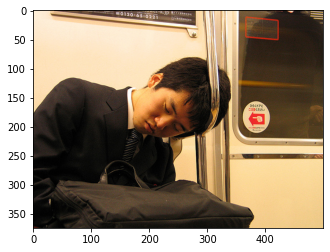

Real Caption: man who has fallen asleep on public transportation
Prediction Caption: young man in suit and tie leans against railing to take nap on public transit
BLEU-1 score: 18.75
BLEU-2 score: 11.18033988749895
BLEU-3 score: 1.3591779906380471e-91
BLEU-4 score: 4.98769305520104e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


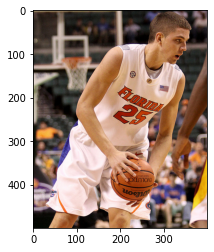

Real Caption: the basketball player is wearing florida jersey
Prediction Caption: basketball player holds the ball during game
BLEU-1 score: 37.5
BLEU-2 score: 23.145502494313785
BLEU-3 score: 2.1032131949153637e-91
BLEU-4 score: 7.176381577237209e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


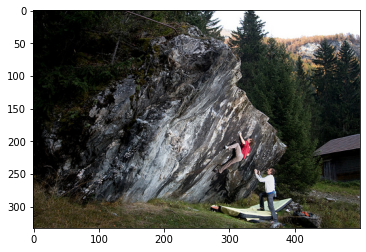

Real Caption: person learning how to rock climb with another person assisting
Prediction Caption: people climbing up cliff
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


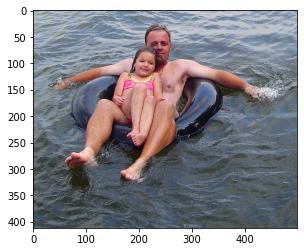

Real Caption: man and girl float on the water in an innertube
Prediction Caption: man and small girl floating in red shirt and orange life vest is floating in orange shirt and orange life vest is floating in orange shirt and orange life vest is floating
BLEU-1 score: 12.121212121212123
BLEU-2 score: 6.154574548966637
BLEU-3 score: 9.499968196054682e-92
BLEU-4 score: 3.7005922416742967e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


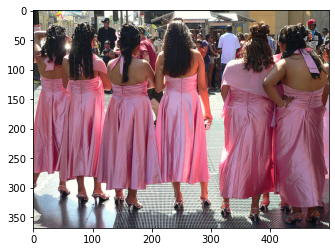

Real Caption: six women wearing <unk> pink dresses in front of crowd
Prediction Caption: the girls dressed in pink dresses one pink dresses and heels looks
BLEU-1 score: 23.076923076923077
BLEU-2 score: 13.867504905630728
BLEU-3 score: 1.5466866120248002e-91
BLEU-4 score: 5.554837769749797e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


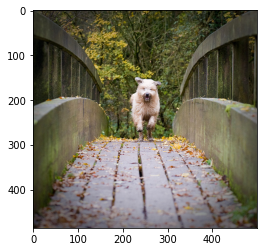

Real Caption: fluffy dog runs across bridge near forest
Prediction Caption: white dog running alongside her
BLEU-1 score: 14.108028748176901
BLEU-2 score: 5.154827976372712e-153
BLEU-3 score: 1.2664232355128374e-183
BLEU-4 score: 9.853445011990207e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


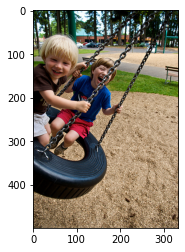

Real Caption: two kids enjoy tire swing
Prediction Caption: two children share swing in playground
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


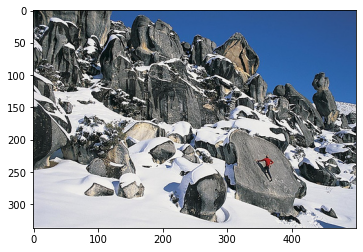

Real Caption: man wearing red shirt scales rock in boulder field
Prediction Caption: crowd of people sit on the top of people is standing on rocky dune
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


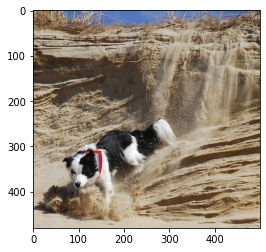

Real Caption: black and white dog is climbing down hill
Prediction Caption: black dog running on sand mound
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


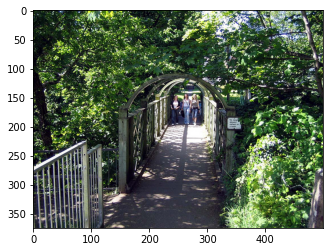

Real Caption: three girls are walking across bridge covered with wood and surrounded by trees
Prediction Caption: three women pose
BLEU-1 score: 2.6349806140466083
BLEU-2 score: 7.861033295866792e-154
BLEU-3 score: 1.780844819131031e-184
BLEU-4 score: 1.357784171206277e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


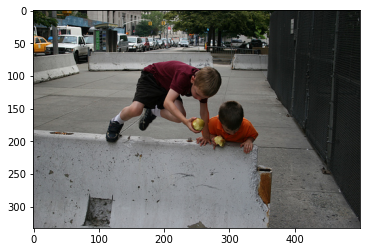

Real Caption: two little boys holding apples near the street
Prediction Caption: two young boys one in pink shirt is smiling boy child child behind them
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


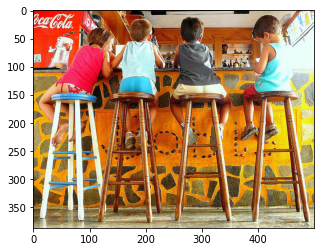

Real Caption: four small children sit on tall stools at restaurant bar
Prediction Caption: four children in bar
BLEU-1 score: 22.07276647028654
BLEU-2 score: 4.2506305475550265e-153
BLEU-3 score: 8.08272033022991e-184
BLEU-4 score: 5.898636777061139e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


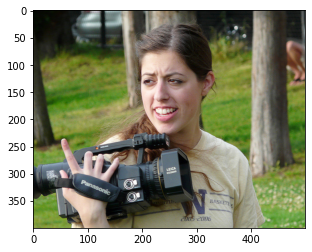

Real Caption: woman holding video camera
Prediction Caption: smiling girls look at the park bench outside
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


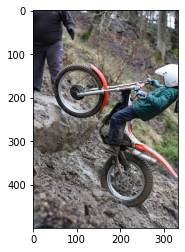

Real Caption: young child rides motorbike through the mud
Prediction Caption: dirt biker in the mud
BLEU-1 score: 28.2160574963538
BLEU-2 score: 21.856064155801842
BLEU-3 score: 1.9010499936561078e-91
BLEU-4 score: 6.416038883891965e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


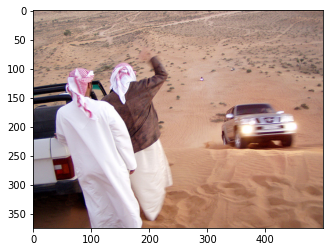

Real Caption: two men in ethnic dress standing in barren landscape
Prediction Caption: two female walking through the sand
BLEU-1 score: 10.735389901075512
BLEU-2 score: 4.236810678370506e-153
BLEU-3 score: 1.073477903059106e-183
BLEU-4 score: 8.416851712392763e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


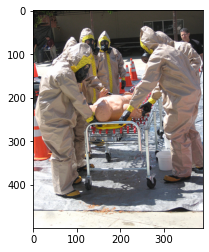

Real Caption: there is man on stretcher surrounded by men in hazmat suits
Prediction Caption: the children are racing guitar
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


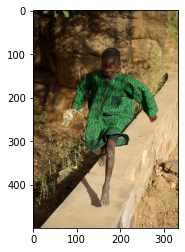

Real Caption: an african boy in large green shirt is running barefoot along wall
Prediction Caption: boy in green is running away in front of rock and water
BLEU-1 score: 38.46153846153847
BLEU-2 score: 25.318484177091666
BLEU-3 score: 2.2195551978722937e-91
BLEU-4 score: 7.505697654413981e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


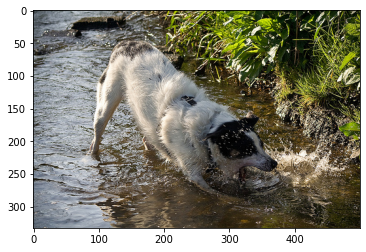

Real Caption: white dog is splashing in an outdoor stream next to grassy bank
Prediction Caption: black and white dog is splashing in shallow water
BLEU-1 score: 40.936537653899094
BLEU-2 score: 38.595337831160656
BLEU-3 score: 38.84961594004602
BLEU-4 score: 32.160943495184156
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


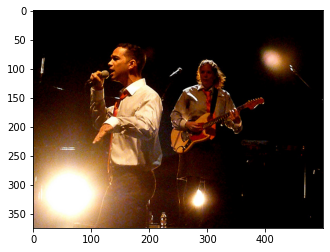

Real Caption: singer and guitarist performing
Prediction Caption: man with white shirt and tie sings into microphone while woman wearing white shirt and tie sings into microphone while woman wearing white shirt and tie sings into microphone while woman wearing
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


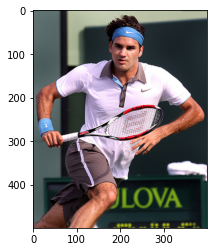

Real Caption: man in blue headband plays tennis
Prediction Caption: closeup of man wearing blue headband is playing tennis
BLEU-1 score: 40.0
BLEU-2 score: 21.08185106778919
BLEU-3 score: 1.9886052149911738e-91
BLEU-4 score: 6.848990852664275e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


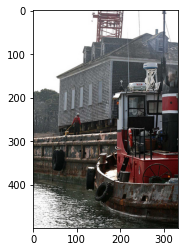

Real Caption: red tugboat is about to dock at port
Prediction Caption: man sitting on the dock
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


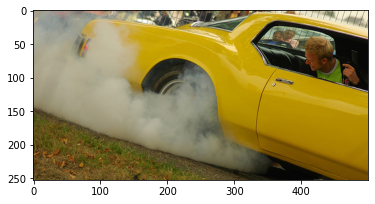

Real Caption: yellow muscle car is burning rubber while man in the car with blonde hair looks at the tire
Prediction Caption: yellow car car its owner is creating smoke by spinning its
BLEU-1 score: 20.21768865708778
BLEU-2 score: 5.223533056060786e-153
BLEU-3 score: 1.117179715016979e-183
BLEU-4 score: 8.396161215621529e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


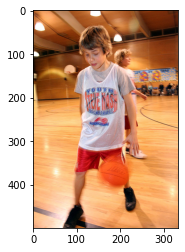

Real Caption: boy dribbles basketball in the gymnasium
Prediction Caption: boy in shorts shirt dribbles basketball
BLEU-1 score: 57.14285714285714
BLEU-2 score: 30.860669992418384
BLEU-3 score: 2.499462007255115e-91
BLEU-4 score: 8.286571670851009e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


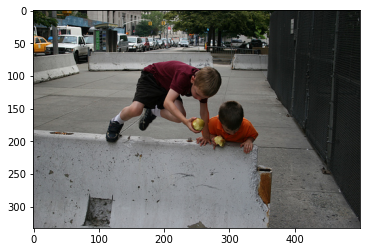

Real Caption: two little boys holding apples near the street
Prediction Caption: two young boys one in pink shirt is smiling boy child child behind them
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


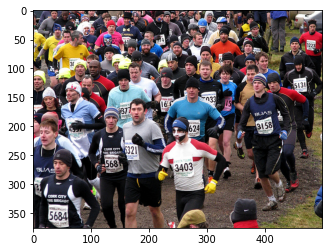

Real Caption: large pack of men jog in race
Prediction Caption: people wearing paper numbers on their shirts walking along the hill
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


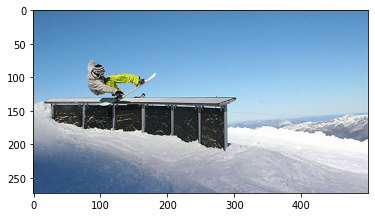

Real Caption: the man is performing trick on snowboard high in the air
Prediction Caption: someone in yellow pants is on ramp over the snow
BLEU-1 score: 36.36363636363637
BLEU-2 score: 8.995097368733391e-153
BLEU-3 score: 1.890631331334428e-183
BLEU-4 score: 1.4147351699132999e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


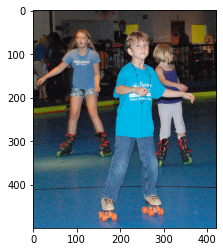

Real Caption: little boy skating in roller rink two little girls in background
Prediction Caption: three people skating in skating rink
BLEU-1 score: 24.202205228903967
BLEU-2 score: 15.092726661824571
BLEU-3 score: 1.2947819705326313e-91
BLEU-4 score: 4.35483727327488e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


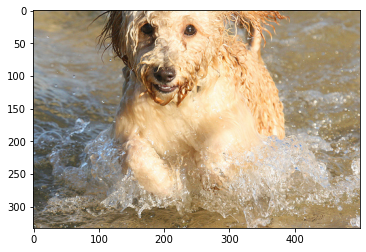

Real Caption: wet blonde dog running through water
Prediction Caption: the white dog is running through water
BLEU-1 score: 50.0
BLEU-2 score: 37.79644730092272
BLEU-3 score: 32.585561793662905
BLEU-4 score: 4.7975972319129444e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


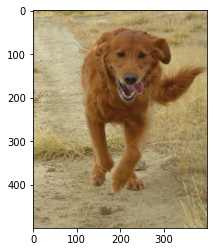

Real Caption: brown dog runs over dirt and grass background
Prediction Caption: dog running towards the camera
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


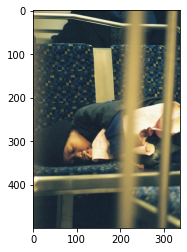

Real Caption: child in black cap sleeping across two chairs
Prediction Caption: small boy in pink jacket with pink blanket with pink blanket on seat at terminal
BLEU-1 score: 6.25
BLEU-2 score: 3.7291703656001405e-153
BLEU-3 score: 1.1147325022884998e-183
BLEU-4 score: 9.10915994722721e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


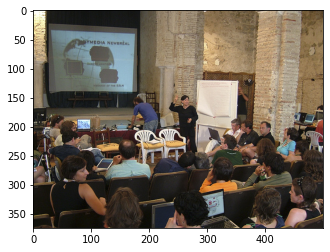

Real Caption: class full of students
Prediction Caption: group of people are at conference watching
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


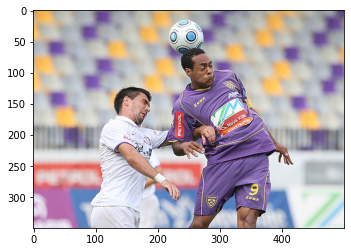

Real Caption: man on the purple team heading the ball in game against the white team
Prediction Caption: two guys playing soccer ball on his head and white male soccer player in purple uniform with soccer ball on his head and white male soccer player in purple uniform with soccer
BLEU-1 score: 15.151515151515154
BLEU-2 score: 5.806310384436393e-153
BLEU-3 score: 1.4539299344735666e-183
BLEU-4 score: 1.136638440788832e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


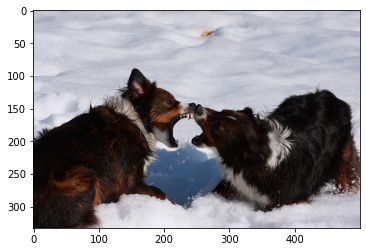

Real Caption: two dogs fight in the snow
Prediction Caption: two black and black dog is running along the large snow
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


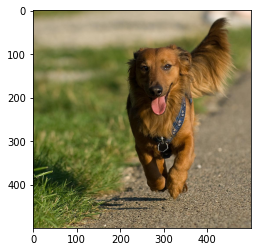

Real Caption: brown dog running down paved pathway
Prediction Caption: dog is running down road
BLEU-1 score: 50.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


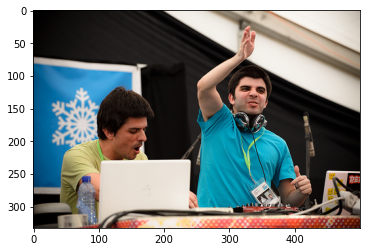

Real Caption: man wearing blue shirt and headphones around his neck raises his arm
Prediction Caption: two people are sitting at computer
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


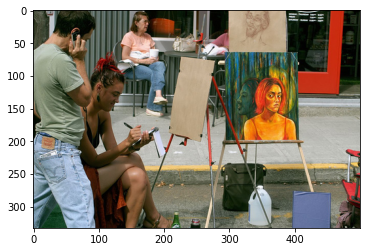

Real Caption: woman drawing portrait while man on cellphone watches
Prediction Caption: small boys dance artist in the background
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


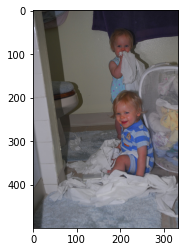

Real Caption: two young children playing with toilet paper
Prediction Caption: two baby and laughs
BLEU-1 score: 13.406400920712787
BLEU-2 score: 4.471666651098519e-153
BLEU-3 score: 1.0592485173532028e-183
BLEU-4 score: 8.166726842395623e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


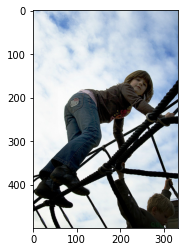

Real Caption: kid is climbing on rope course
Prediction Caption: young girl is climbing up the swing set
BLEU-1 score: 22.22222222222222
BLEU-2 score: 16.666666666666668
BLEU-3 score: 1.7270804940051994e-91
BLEU-4 score: 6.08970970641905e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


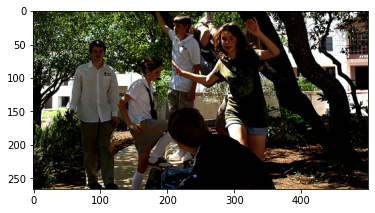

Real Caption: teenagers socializing in the shade
Prediction Caption: group of people are gathered outside
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


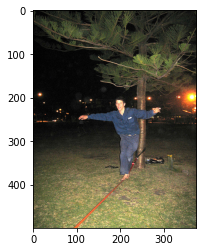

Real Caption: man walking tightrope low to the ground between two trees
Prediction Caption: man walks on low tightrope under tree
BLEU-1 score: 29.20502936517768
BLEU-2 score: 7.114006032055006e-153
BLEU-3 score: 1.4860807846344539e-183
BLEU-4 score: 1.1103055738259992e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


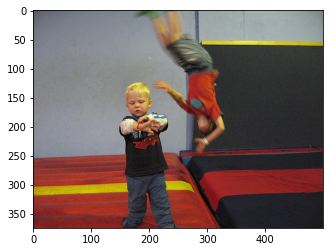

Real Caption: young boy is standing near another doing back flip
Prediction Caption: little boy in yellow shirt does flip
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


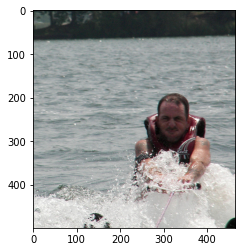

Real Caption: man waterskies with life jacket
Prediction Caption: man holds his boogie board in the water
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


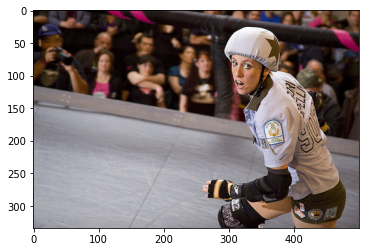

Real Caption: woman with gray helmet and black safety pads skates past the photographer
Prediction Caption: woman wearing helmet is in rollerskating competition
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


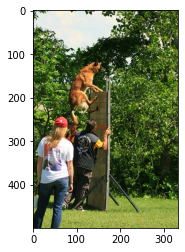

Real Caption: dog climbing over wall
Prediction Caption: two people look on
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


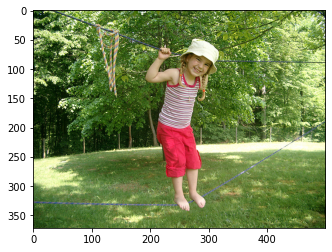

Real Caption: little girl in hat striped shirt and red shorts walking on rope bridge
Prediction Caption: girl in hat and red shirt is wearing hat stands on his back flip
BLEU-1 score: 46.666666666666664
BLEU-2 score: 31.62277660168379
BLEU-3 score: 23.217582333658846
BLEU-4 score: 3.617014666551307e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


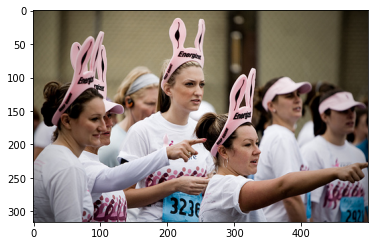

Real Caption: there are women wearing pink energizer bunny ears
Prediction Caption: several women have with energizer bunny ears point to the right
BLEU-1 score: 33.33333333333333
BLEU-2 score: 24.618298195866544
BLEU-3 score: 21.614978940479492
BLEU-4 score: 3.4077295621678845e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


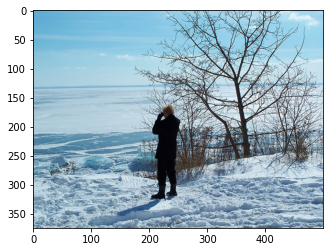

Real Caption: man in black looks out over snowy landscape
Prediction Caption: man looks out over frozen
BLEU-1 score: 47.76875403825262
BLEU-2 score: 37.00151777184613
BLEU-3 score: 31.798585012189168
BLEU-4 score: 4.446808895758207e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


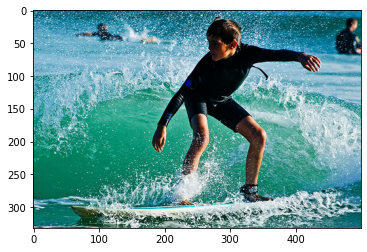

Real Caption: boy surfs
Prediction Caption: girl jumping in the water behind him
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


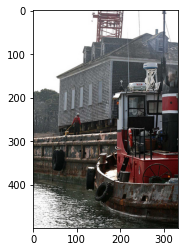

Real Caption: the boat is pulled up to dock and man is pulling something out of the water
Prediction Caption: man sitting on the dock
BLEU-1 score: 9.443780141878094
BLEU-2 score: 1.9922006679240132e-153
BLEU-3 score: 3.928923055701026e-184
BLEU-4 score: 2.8935213297515505e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


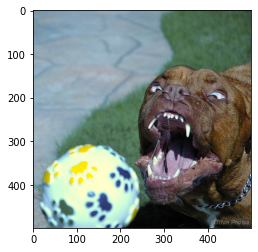

Real Caption: brown dog trying to bite white ball with yellow green and blue puppy toes
Prediction Caption: intense looking dog is about to get ball with paw on its wings
BLEU-1 score: 28.57142857142857
BLEU-2 score: 14.824986333222023
BLEU-3 score: 1.6099037441710956e-91
BLEU-4 score: 5.74340400309589e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


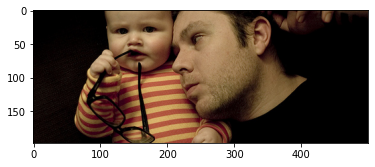

Real Caption: man holds baby which is chewing on eyeglasses
Prediction Caption: giant blanket is looking at the hand of large stick off of large stick off of large stick off of large stick off of large stick off of large stick off of
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


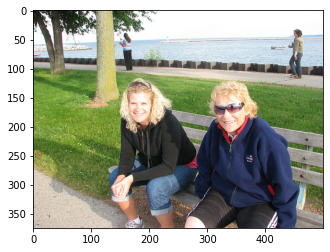

Real Caption: two blond hair ladies are sitting on park bench near body of water
Prediction Caption: two women sitting on bench with women sit on the water
BLEU-1 score: 38.33518394288847
BLEU-2 score: 17.906340134265868
BLEU-3 score: 1.7439376128316212e-91
BLEU-4 score: 6.054524308026741e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


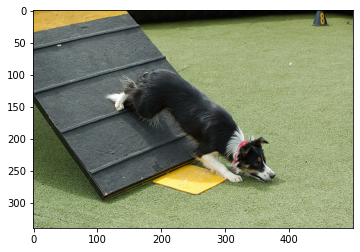

Real Caption: dog climbs down black ramp
Prediction Caption: black and white dog ran down black ramp
BLEU-1 score: 44.44444444444444
BLEU-2 score: 33.333333333333336
BLEU-3 score: 28.853455719062136
BLEU-4 score: 4.335118471269586e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


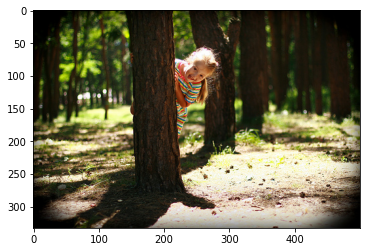

Real Caption: little girl is peaking out from behind tree
Prediction Caption: little blond hair is on the road after other way in the jungle
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


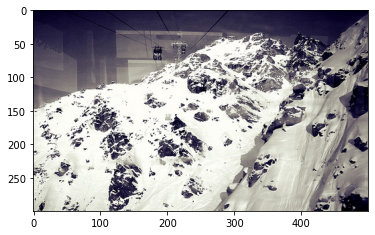

Real Caption: view of some large snowcapped mountains
Prediction Caption: rocking climbing mountain inside building
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


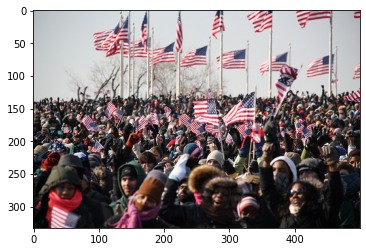

Real Caption: the crowd is waving many american flags
Prediction Caption: large crowd is standing with many american flags while people drinking line up packed without shirt with colorful american flags
BLEU-1 score: 23.809523809523807
BLEU-2 score: 18.898223650461357
BLEU-3 score: 15.213407922357106
BLEU-4 score: 2.5430693274332333e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


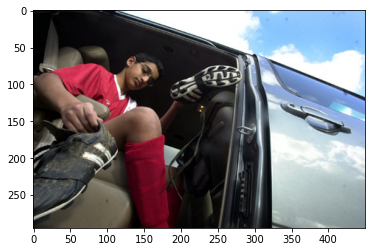

Real Caption: young boy gets out of the van and prepares his shoes for wear during soccer game
Prediction Caption: motorcycle getting pulled out of car
BLEU-1 score: 7.898658475130412
BLEU-2 score: 6.0327000584815975
BLEU-3 score: 5.6125331792975714e-92
BLEU-4 score: 1.9263658580749334e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


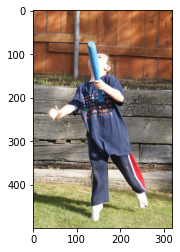

Real Caption: boy plays baseball
Prediction Caption: young man in blue and red and red and red and red and red and red and red and red and red and red and red and red and red and red
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


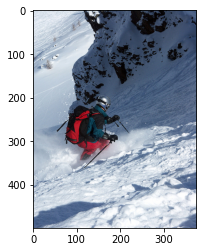

Real Caption: man skis on snowy mountain
Prediction Caption: the skier is skiing downhill
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


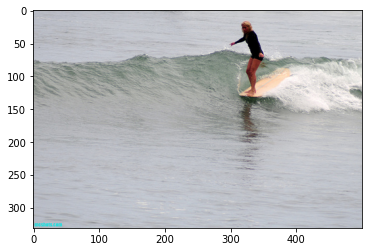

Real Caption: blond girl rides the waves
Prediction Caption: man is coming off of wave
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


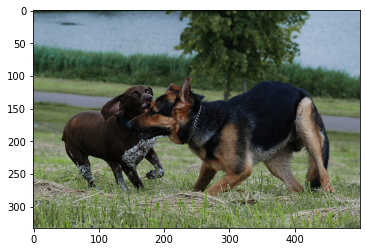

Real Caption: brown dog and german shepherd standing near each other in the grass near water
Prediction Caption: two dogs one has drink in the background
BLEU-1 score: 12.750076016387393
BLEU-2 score: 9.562557012290547
BLEU-3 score: 9.909183413243782e-92
BLEU-4 score: 3.4939917753558776e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


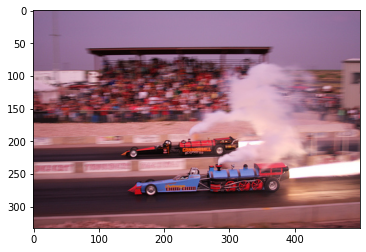

Real Caption: two automobiles race each other and pour smoke from behind
Prediction Caption: two rocket dragsters racing at dragsters
BLEU-1 score: 9.306272250443651
BLEU-2 score: 3.672797542504966e-153
BLEU-3 score: 9.305742700321069e-184
BLEU-4 score: 7.296382734947758e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


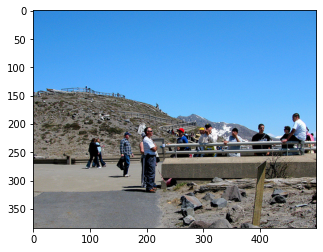

Real Caption: people stand at the bottom of meandering walkway that goes uphill
Prediction Caption: tourists people on are on sunny day
BLEU-1 score: 8.591115984887153
BLEU-2 score: 3.6246559632213337e-153
BLEU-3 score: 9.432335330491414e-184
BLEU-4 score: 7.445183326929417e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


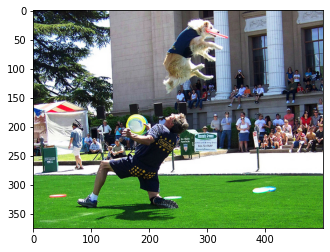

Real Caption: dog with frisbee jumps over man
Prediction Caption: man ducks down as dog flies over his head to fetch frisbee
BLEU-1 score: 30.769230769230766
BLEU-2 score: 8.274286134223026e-153
BLEU-3 score: 1.798215142829991e-183
BLEU-4 score: 1.3568676344828118e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


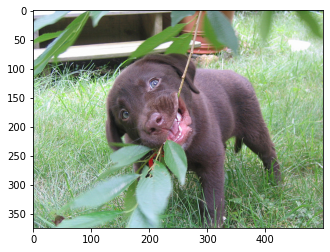

Real Caption: black puppy is biting tree limb
Prediction Caption: puppy is gnawing on leash of on plant branch in the grass
BLEU-1 score: 15.384615384615385
BLEU-2 score: 11.322770341445958
BLEU-3 score: 1.36954071726339e-91
BLEU-4 score: 5.019362538473706e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


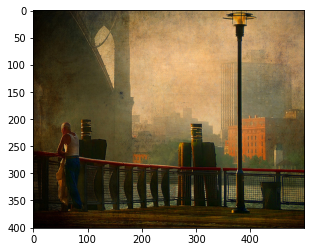

Real Caption: man looks out at the water under bridge and against skyline
Prediction Caption: man on boat with the rocket
BLEU-1 score: 16.13480348593598
BLEU-2 score: 4.5026679202702836e-153
BLEU-3 score: 9.9315714226985e-184
BLEU-4 score: 7.521821744402224e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


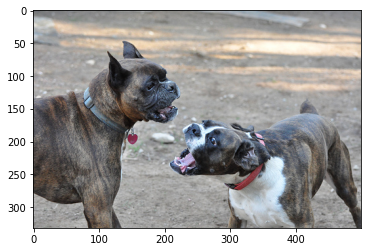

Real Caption: there are two boston terriers biting at each other
Prediction Caption: two dogs sniffing the
BLEU-1 score: 8.986579282344431
BLEU-2 score: 2.997447795420392e-153
BLEU-3 score: 7.100355149153815e-184
BLEU-4 score: 5.474320712955125e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


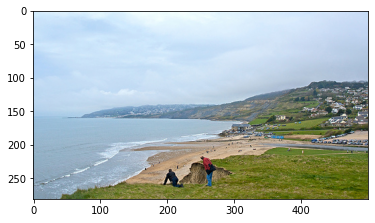

Real Caption: the two men look at the shoreline from atop the bluff
Prediction Caption: two people sit on the top of the top of cliff overlooking lake
BLEU-1 score: 21.428571428571423
BLEU-2 score: 6.905081759897607e-153
BLEU-3 score: 1.6132609611386312e-183
BLEU-4 score: 1.239528818333946e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


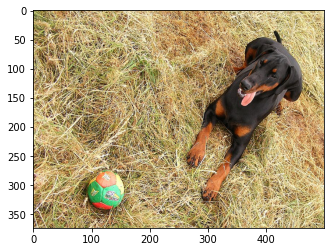

Real Caption: black dog lays next to ball
Prediction Caption: black dog is running through the dry grass with red ball
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


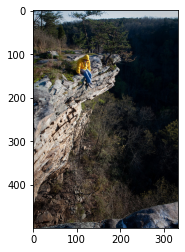

Real Caption: person sitting on the edge of rock outcropping looking down
Prediction Caption: person in yellow sits in the background
BLEU-1 score: 19.470019576785123
BLEU-2 score: 5.808561601872144e-153
BLEU-3 score: 1.3158762272049197e-183
BLEU-4 score: 1.0032743411283238e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


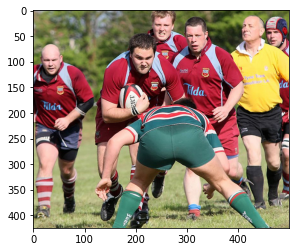

Real Caption: while the green team gets ready to tackle the red team has the ball
Prediction Caption: group of men are wearing red and white are walking one has the referee watching
BLEU-1 score: 18.75
BLEU-2 score: 11.18033988749895
BLEU-3 score: 1.3591779906380471e-91
BLEU-4 score: 4.98769305520104e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


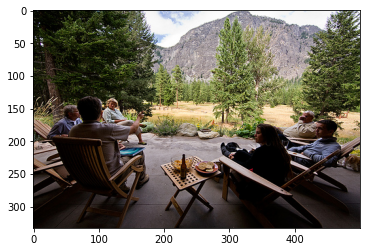

Real Caption: group of adults sit in wood lawn chairs talking surrounded by wilderness
Prediction Caption: group of people sitting in lounge chairs on patio looking at mountains
BLEU-1 score: 30.769230769230766
BLEU-2 score: 16.012815380508712
BLEU-3 score: 1.6861024029072228e-91
BLEU-4 score: 5.969061643530969e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


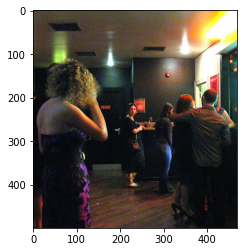

Real Caption: woman in purple dress plays with her hair while waiting in lobby
Prediction Caption: people in bar headband on stage
BLEU-1 score: 6.993452279385044
BLEU-2 score: 2.7600239552551947e-153
BLEU-3 score: 6.99305433449238e-184
BLEU-4 score: 5.483065946899793e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


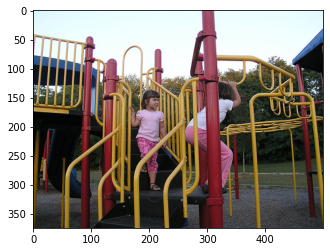

Real Caption: two young girls wearing pink playing on playground
Prediction Caption: two babies plays on yellow and pink playing on yellow and pink playing on yellow and pink playing on yellow and pink playing on yellow and pink playing on yellow and pink
BLEU-1 score: 12.121212121212123
BLEU-2 score: 8.703882797784892
BLEU-3 score: 8.249342068276574
BLEU-4 score: 1.5270462878358646e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


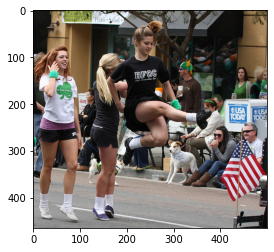

Real Caption: girl in black doing jump while other girls walk behind her during parade
Prediction Caption: group of young dancer marches in the parade
BLEU-1 score: 14.248453076221212
BLEU-2 score: 4.5086465338368087e-153
BLEU-3 score: 1.0457385906395474e-183
BLEU-4 score: 8.020204191025903e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


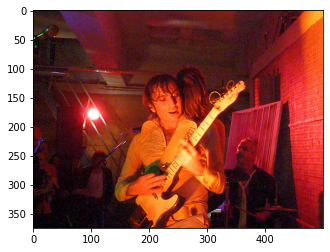

Real Caption: man playing guitar under the lights with other people in the background
Prediction Caption: man in fancy band plays guitar in dark room
BLEU-1 score: 24.561922592339457
BLEU-2 score: 6.689196389553559e-153
BLEU-3 score: 1.4611141238590901e-183
BLEU-4 score: 1.1039000191006553e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


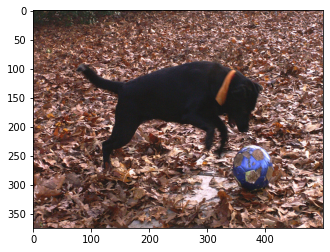

Real Caption: black dog in an orange bandanna pouncing on blue soccer ball in an area covered by fallen leaves
Prediction Caption: black dog with blue ball
BLEU-1 score: 9.022352215774179
BLEU-2 score: 4.941745830336237
BLEU-3 score: 3.741932823270406e-92
BLEU-4 score: 1.2198823172347265e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


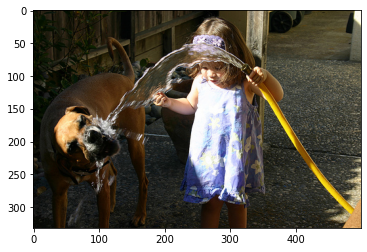

Real Caption: the little girl is holding yellow hose for brown dog
Prediction Caption: young girl holds the leash of yellow and yellow toy getting soaked with water hose from which brown dog holds the leash of yellow and yellow toy getting soaked with water hose
BLEU-1 score: 18.181818181818183
BLEU-2 score: 7.5377836144440895
BLEU-3 score: 1.0728759969151994e-91
BLEU-4 score: 4.095378526044107e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


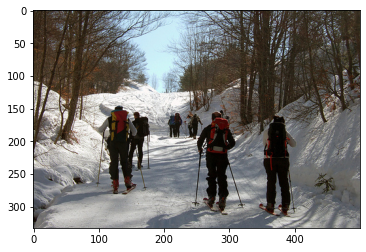

Real Caption: skiers walking up the slope
Prediction Caption: group of skiers following trail through the forest
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


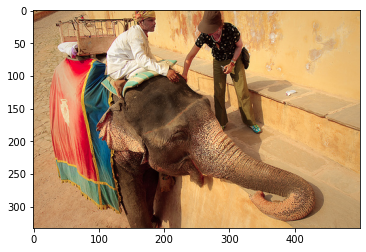

Real Caption: woman is petting man elephant
Prediction Caption: man sitting on an elephant with riding seat is talking to female tourist
BLEU-1 score: 21.428571428571423
BLEU-2 score: 6.905081759897607e-153
BLEU-3 score: 1.6132609611386312e-183
BLEU-4 score: 1.239528818333946e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


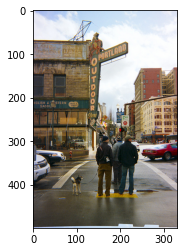

Real Caption: some people waiting to cross busy street in portland oregon
Prediction Caption: three people wait to cross city street corner with shopping cart with policeman waiting on lease
BLEU-1 score: 29.411764705882355
BLEU-2 score: 13.558153613666013
BLEU-3 score: 1.5258915201286794e-91
BLEU-4 score: 5.492530671320407e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


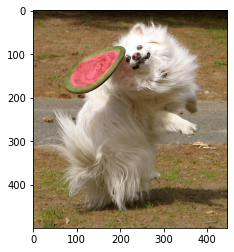

Real Caption: white furry dog jumping to catch frisbee
Prediction Caption: white dog is attempting to catch red collar is jumping and pink collar is jumping and pink collar is jumping and pink collar is jumping and pink collar is jumping and pink
BLEU-1 score: 15.151515151515154
BLEU-2 score: 6.8810235320397535
BLEU-3 score: 1.0157694694037605e-91
BLEU-4 score: 3.912899894057541e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


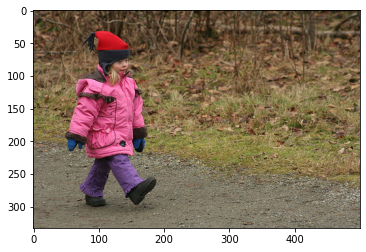

Real Caption: young girl in pink jacket walking down gravel path in wooded area
Prediction Caption: girl in pink jacket and red hat walking near grass
BLEU-1 score: 41.50457801283011
BLEU-2 score: 33.71847857444411
BLEU-3 score: 31.986336480747912
BLEU-4 score: 22.652581507881553
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


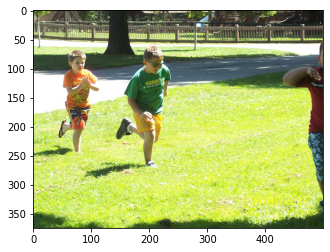

Real Caption: two young boys running on grassy field
Prediction Caption: two women are playing in shot
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


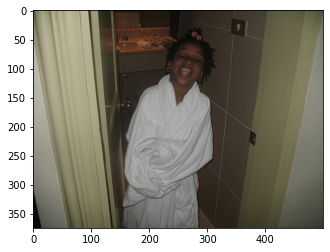

Real Caption: young black child is wrapped in white robe and standing in bathroom doorway
Prediction Caption: young black girl emerges from the bathroom wrapped in bathrobe and towel
BLEU-1 score: 46.15384615384615
BLEU-2 score: 27.735009811261456
BLEU-3 score: 2.3443385210458598e-91
BLEU-4 score: 7.855726910762709e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


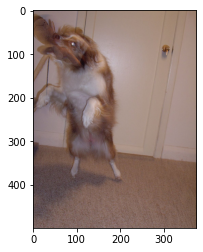

Real Caption: dog standing up on two legs with something in his mouth
Prediction Caption: dog is jumping up in its mouth
BLEU-1 score: 34.364463939548614
BLEU-2 score: 7.24931192644268e-153
BLEU-3 score: 1.4296746921307344e-183
BLEU-4 score: 1.052907923529733e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


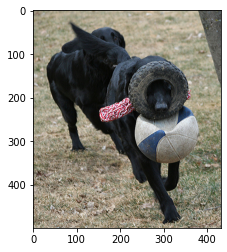

Real Caption: black dog is chasing another black dog that carrying ball in its mouth
Prediction Caption: black dog running in his mouth
BLEU-1 score: 24.249876895825707
BLEU-2 score: 13.096430344179847
BLEU-3 score: 1.0607038046802743e-91
BLEU-4 score: 3.51659600086504e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


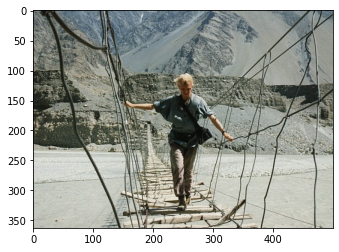

Real Caption: person with shoulder bag is walking across <unk> wooden <unk> bridge
Prediction Caption: hiker navigates rope and wood bridge over wire fence in ravine
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


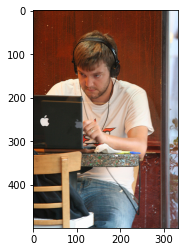

Real Caption: young man with headphones looking at <unk> laptop computer
Prediction Caption: man sitting in the distance
BLEU-1 score: 10.10884432854389
BLEU-2 score: 3.693595645692774e-153
BLEU-3 score: 9.074319006831119e-184
BLEU-4 score: 7.060301868108111e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


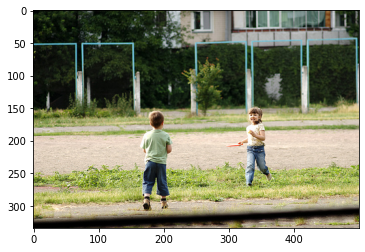

Real Caption: little boy and little girl playing together outside
Prediction Caption: two children playing in field
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


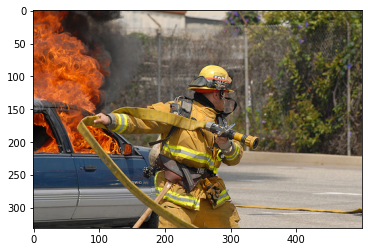

Real Caption: the firefighter has hose ready to tackle car fire
Prediction Caption: fireman pulling out firehose next to blue car engulfed in flames
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
BLEU-1 count: 176
BLEU-2 count: 71
BLEU-3 count: 26
BLEU-4 count: 4
BLEU-1 Total: 45.05400103351277
BLEU-2 Total: 16.15466393916535
BLEU-3 Total: 6.606868034990447
BLEU-4 Total: 1.1901005648945793
BLEU-1 Average: 0.255988642235868
BLEU-2 Average: 0.22753047801641338
BLEU-3 Average: 0.2541103090380941
BLEU-4 Average: 0.2975251412236448
Real Caption: the firefighter has hose ready to tackle car fire
Prediction Caption: fireman pulling out firehose next to blue car engulfed in flames


In [ ]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(250):    
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]

    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    result, attention_plot = evaluate(image)

    # remove <start> and <end> from the real_caption
    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    #Image.open(img_name_val[rid])
    #remove "<unk>" in result
    for i in result:
        if i=="<unk>":
            result.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result        
    result_join = ' '.join(result)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = result
    print ('Real Caption:', real_caption)
    print ('Prediction Caption:', result_final)
    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")

    print ('Real Caption:', real_caption)
    print ('Prediction Caption:', result_final)

    #plot_attention(image, result, attention_plot)

In [ ]:
#-------------------END------------------------